##### Multiple strategies:

##### Atemporal regression.
Do a standard randomized split on the data.
Train up a polynomial, degree 2 LASSO model on selected parameters from visualizations.
Test model to see if it holds water.
Look at coefficients & suggest interventions to reverse attendance declines.

##### Time series.
Split data into 20th & 21st century, train & test.
Train up a similar model.
See how much adding the time factor adds to the fit (representing external cultural changes).
Change train / test splits as needed.
Project the 2020s with various rules / culture interventions.

In [19]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.axes
import seaborn as sns
%matplotlib inline
sns.set()
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
import statsmodels.api as sm
import statsmodels.formula.api as smf
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor

In [2]:
with open('bat_rate_data.pkl','rb') as cellar:
    bat_df = pickle.load(cellar)
with open('pitch_rate_data.pkl','rb') as cellar:
    pitch_df = pickle.load(cellar)
with open('field_rate_data.pkl','rb') as cellar:
    field_df = pickle.load(cellar)
# with open('sp.pkl','rb') as cellar:
#    sp_df = pickle.load(cellar)
# with open('sb.pkl','rb') as cellar:
#    sb_df = pickle.load(cellar)
with open('att.pkl','rb') as cellar:
    att_df = pickle.load(cellar)

###### Target:
* NormAtt/G * 1000000 (or Att)
= attendance per game in units of parts per million of the U.S. population (using ppm because as a fraction it's really small and seaborn actually gagged on it in some of the pairplots & treated it as zero); the calculation was already done in the visualization notebooks

###### Flagship parameters for model:
* BA, SLG, HR/G, 'SB/G', SH/G, SO9, ERA, DefEff, GmDur

###### "On-deck" parameters:
* IBB/G, 'CS/G', '3B/G', SF/G, DP/G, A/G, Fld% 

In [25]:
y = pd.DataFrame(pitch_df['Att'])
X = [bat_df['BA'],bat_df['SLG'],bat_df['HR/G'],
     bat_df['SB/G'],bat_df['SH/G'],pitch_df['SO9'],
     pitch_df['ERA'],field_df['DefEff'],att_df['GmDur'],
     bat_df['IBB/G'],bat_df['CS/G'],bat_df['3B/G'],
     bat_df['SF/G'],field_df['DP/G'],field_df['A/G'],
     field_df['Fld%']]
X = pd.DataFrame(X)
X = X.transpose()
# X = X.fillna(0)

Let me go back to the visualization notebooks and comment on the distribution of each of these variables individually:
* Att: Bimodal and skewed high.
* BA: Skewed a bit low.
* SLG: Skewed high with a narrow peak.
* HR/G: Oooh. Ugly. Peak at near zero and then a divot and then a skewed low distribution. Should consider dropping that one, or cutting the pre-1920 era which would (check!) get rid of that awful low end.
* SB/G: Ugly, bimodal, both flat square dists.
* SH/G: Ugly, bimodal, the upper end skewed high (dead ball era?).
* SO9: ANOTHER bimodal, big low mode, broad high mode.
* ERA: Just skewed high.
* DefEff: Double peak, skewed high.
* GmDur: Ugly, *tri*modal.
* IBB/G: Mostly normal, split peak, skewed a bit high.
* CS/G: Skewed hard low.
* 3B/G: Bimodal, low mode skewed hard low, upper mode skewed high.
* SF/G: Ugly, patchy, and of course has only been tracked since the 50s.
* DP/G: Narrow single mode with long low tail.
* A/G: Bimodal.
* Fld%: Hard high skew.

#### Conclusion:
I rather think there's a LOT to be said for cutting at 1920 and dropping the dead ball era. The noise in that data is extreme, the trends are different.

In [26]:
y = y.loc[1920:2019]
print(y.head(2),y.tail(2))

            Att
1920  69.425136
1921  64.519993             Att
2018  87.725367
2019  85.906654


In [27]:
X = X.loc[1920:2019]

In [28]:
X.head(2)

,BA,SLG,HR/G,SB/G,SH/G,SO9,ERA,DefEff,GmDur,IBB/G,CS/G,3B/G,SF/G,DP/G,A/G,Fld%
1920,0.276,0.372,0.253247,0.701299,1.233766,2.9,3.46,0.685,NaN,NaN,0.636364,0.512987,NaN,0.798701,13.370130,0.966
1921,0.291,0.403,0.383117,0.603896,1.214286,2.8,4.03,0.677,NaN,NaN,0.532468,0.551948,NaN,0.883117,12.980519,0.966


Ok, let's redo a correlation matrix.

In [29]:
yX = pd.concat([y,X],axis=1)
Rmat = yX.corr()
Rmat.sort_values('Att',ascending=False)

,Att,BA,SLG,HR/G,SB/G,SH/G,SO9,ERA,DefEff,GmDur,IBB/G,CS/G,3B/G,SF/G,DP/G,A/G,Fld%
Att,1.000000,-0.276980,0.398534,0.664850,0.459241,-0.541370,0.630233,0.273438,0.010320,0.689743,-0.196397,0.182858,-0.642233,0.567671,-0.062967,-0.629353,0.754517
Fld%,0.754517,-0.620299,0.322541,0.875272,0.337442,-0.868835,0.932487,0.129550,0.153555,0.941893,-0.405043,-0.110556,-0.938751,0.030554,-0.213739,-0.931195,1.000000
GmDur,0.689743,-0.325505,0.537747,0.883599,0.481140,-0.827851,0.925341,0.324111,-0.273871,1.000000,-0.345199,0.028231,-0.885362,0.104829,-0.476014,-0.883859,0.941893
HR/G,0.664850,-0.405984,0.615283,1.000000,0.201494,-0.799795,0.890854,0.428937,-0.024701,0.883599,-0.473570,-0.224928,-0.799948,-0.083410,-0.107399,-0.901360,0.875272
SO9,0.630233,-0.583830,0.382211,0.890854,0.343233,-0.814189,1.000000,0.149785,-0.003993,0.925341,-0.398711,-0.115840,-0.878625,-0.331557,-0.423654,-0.924675,0.932487
SF/G,0.567671,0.743926,0.277700,-0.083410,0.581738,0.095456,-0.331557,0.399035,-0.283219,0.104829,0.056840,0.537737,0.095794,1.000000,0.352301,0.248539,0.030554
SB/G,0.459241,0.043792,0.214223,0.201494,1.000000,-0.156712,0.343233,0.092082,-0.297500,0.481140,0.140652,0.640674,-0.308980,0.581738,-0.476469,-0.117361,0.337442
SLG,0.398534,0.460079,1.000000,0.615283,0.214223,-0.167932,0.382211,0.935518,-0.713701,0.537747,-0.525476,-0.198151,-0.105824,0.277700,-0.015949,-0.354489,0.322541
ERA,0.273438,0.604029,0.935518,0.428937,0.092082,-0.056693,0.149785,1.000000,-0.728558,0.324111,-0.534978,-0.276169,0.057263,0.399035,0.168058,-0.201162,0.129550
CS/G,0.182858,0.073046,-0.198151,-0.224928,0.640674,0.231182,-0.115840,-0.276169,-0.012306,0.028231,0.511347,1.000000,0.074921,0.537737,-0.245048,0.345667,-0.110556


Keeping in mind insights from below, the top four allowable stats:
* Fld%
* HR/G
* 3B/G
* SO9

That's a nice mix: one apiece of fielding, hitting, speed, pitching.

In [31]:
X = X.fillna(0)
for col in X.columns:
    model = sm.OLS(y,sm.add_constant(X[col]))
    results = model.fit()
    print(results.summary())

                            OLS Regression Results                            
Dep. Variable:                    Att   R-squared:                       0.077
Model:                            OLS   Adj. R-squared:                  0.067
Method:                 Least Squares   F-statistic:                     8.143
Date:                Thu, 16 Apr 2020   Prob (F-statistic):            0.00527
Time:                        13:36:07   Log-Likelihood:                -433.27
No. Observations:                 100   AIC:                             870.5
Df Residuals:                      98   BIC:                             875.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        201.8327     41.953      4.811      0.0

                            OLS Regression Results                            
Dep. Variable:                    Att   R-squared:                       0.396
Model:                            OLS   Adj. R-squared:                  0.390
Method:                 Least Squares   F-statistic:                     64.27
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           2.33e-12
Time:                        13:36:07   Log-Likelihood:                -412.04
No. Observations:                 100   AIC:                             828.1
Df Residuals:                      98   BIC:                             833.3
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        250.8510     21.086     11.897      0.0

In [17]:
len(X.columns)

16

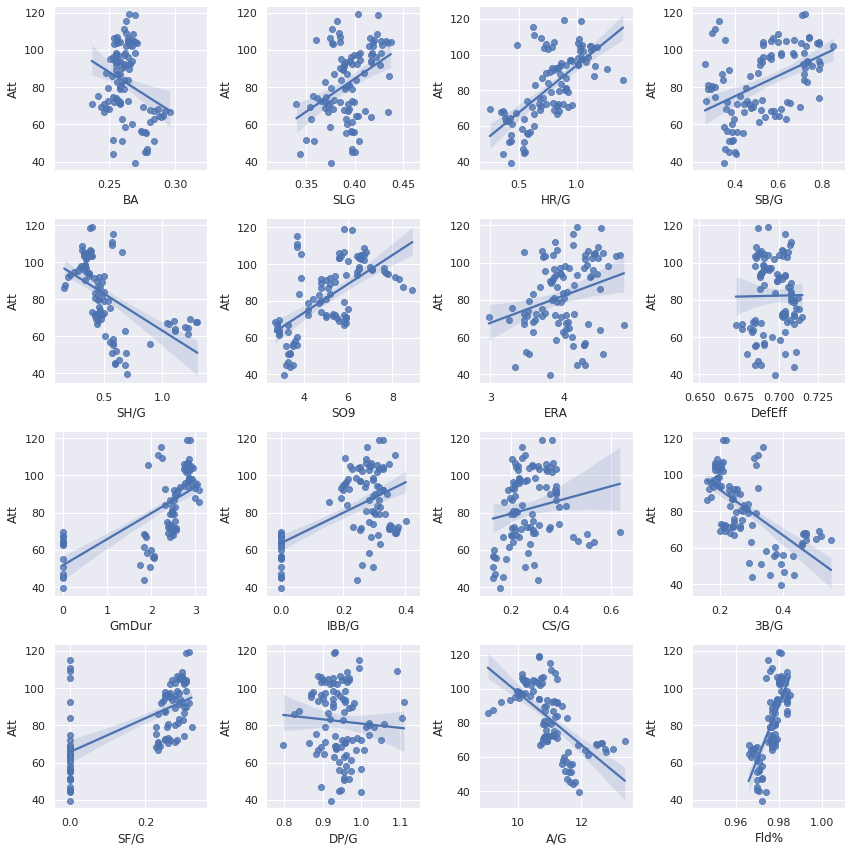

In [22]:
f,axes = plt.subplots(4, 4, figsize=(12,12))
sns.despine(left=True)
for i, col in enumerate(X.columns):
    sns.regplot(X[col],y,ax=axes[i//4,i%4])
plt.tight_layout()

Right. At this point, I think I need to say farewell to GmDur, IBB/G, SF/G just because I don't want to bother with cutting them down to the eras when those stats are available.

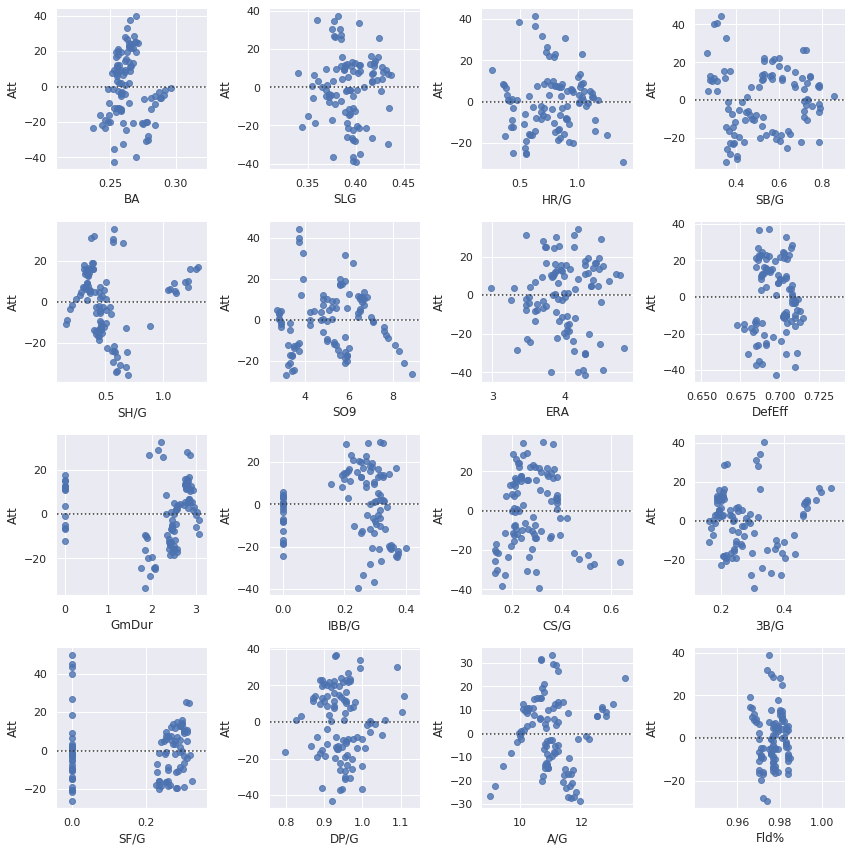

In [23]:
f,axes = plt.subplots(4, 4, figsize=(12,12))
sns.despine(left=True)
for i, col in enumerate(X.columns):
    sns.residplot(X[col],y,ax=axes[i//4,i%4])
plt.tight_layout()

I'm not sure what I've gained beyond looking at the correlation matrix, but by God it looks cool to be able to automate all of that.

Once again, the top four allowable stats:
* Fld%
* HR/G
* 3B/G
* SO9

That's a nice mix: one apiece of fielding, hitting, speed, pitching.
Here's a straight linear regression on those four as a baseline.

In [33]:
# a straight linear regression as a baseline
X1 = pd.concat([X['Fld%'],X['HR/G'],X['3B/G'],X['SO9']],axis=1)

for i in range(3):
    X1tr, X1v, y1tr, y1v = train_test_split(X1, y, test_size=0.3)
    lin_atemp = LinearRegression()
    lin_atemp.fit(X1tr,y1tr)
    print(lin_atemp.score(X1tr,y1tr),lin_atemp.score(X1v,y1v),'\n')
    sm_atemp = sm.OLS(y1tr,sm.add_constant(X1tr))
    at_res = sm_atemp.fit()
    print(at_res.summary(),'\n')

0.6906312449816817 0.41784599419241486
                            OLS Regression Results                            
Dep. Variable:                    Att   R-squared:                       0.691
Model:                            OLS   Adj. R-squared:                  0.672
Method:                 Least Squares   F-statistic:                     36.28
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           6.46e-16
Time:                        13:43:15   Log-Likelihood:                -264.13
No. Observations:                  70   AIC:                             538.3
Df Residuals:                      65   BIC:                             549.5
Df Model:                           4                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -4

That's a wee bit disturbing, the way HR/G has high p-values for 2 out of 3 splits.

0.6230965508248654 0.6909000826743379 



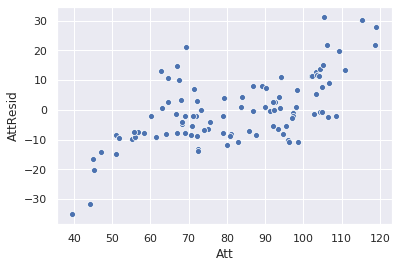

In [52]:
X1tr, X1v, y1tr, y1v = train_test_split(X1, y, test_size=0.3)
lin_atemp = LinearRegression()
lin_atemp.fit(X1tr,y1tr)
print(lin_atemp.score(X1tr,y1tr),lin_atemp.score(X1v,y1v),'\n')
yp = lin_atemp.predict(X1)
ypdf = pd.DataFrame(yp,index=y.index,columns=['PredAtt'])
yres = pd.DataFrame(y['Att']-ypdf['PredAtt'],index=y.index,columns=['AttResid'])
yplot = pd.concat([y,yres],axis=1)
sns.scatterplot(x='Att',y='AttResid',data=yplot)

0.6753218638911195 0.577773731014794 



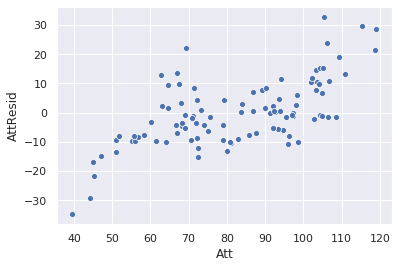

In [53]:
X1tr, X1v, y1tr, y1v = train_test_split(X1, y, test_size=0.3)
lin_atemp = LinearRegression()
lin_atemp.fit(X1tr,y1tr)
print(lin_atemp.score(X1tr,y1tr),lin_atemp.score(X1v,y1v),'\n')
yp = lin_atemp.predict(X1)
ypdf = pd.DataFrame(yp,index=y.index,columns=['PredAtt'])
yres = pd.DataFrame(y['Att']-ypdf['PredAtt'],index=y.index,columns=['AttResid'])
yplot = pd.concat([y,yres],axis=1)
sns.scatterplot(x='Att',y='AttResid',data=yplot)

0.6414043296031509 0.6549927356159951 



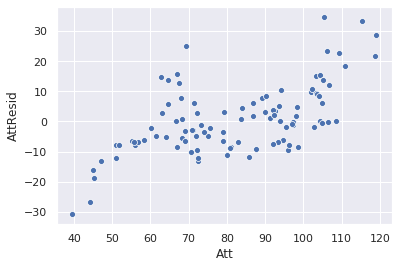

In [54]:
X1tr, X1v, y1tr, y1v = train_test_split(X1, y, test_size=0.3)
lin_atemp = LinearRegression()
lin_atemp.fit(X1tr,y1tr)
print(lin_atemp.score(X1tr,y1tr),lin_atemp.score(X1v,y1v),'\n')
yp = lin_atemp.predict(X1)
ypdf = pd.DataFrame(yp,index=y.index,columns=['PredAtt'])
yres = pd.DataFrame(y['Att']-ypdf['PredAtt'],index=y.index,columns=['AttResid'])
yplot = pd.concat([y,yres],axis=1)
sns.scatterplot(x='Att',y='AttResid',data=yplot)

I am calculating the residual as real - predicted, meaning that the model is consistently overpredicting at low real attendance and underpredicting at high real attendance. Polynomial features should be able to do a considerable amount for this.

This model is certainly unstable; I guess I'm not surprised, with only 119 data points. Hopefully I don't have to go back and rethink things completely and try to pull data at the team... or player... level. I don't know that I would have any attendance data to work with.

Of course, I'm throwing messy, random variables into the regression that probably really are unrelated to attendance trends. I can do three things about this:
* Lasso may be able to prune the crap variables in an automated way.
* I'll do Ridge since it's there.
* If I have to, I can go back to my visualizations and prune variables manually.

Beyond that, there is polynomial feature selection. Forgot about that. There would be a blizzard of features at that point, something like as many features as lines of data, if I stick all of X1 in there, so I'll need to prune that down regardless.

At the moment, though, the guidance suggests I try a "full" model with all features. That will probably be a dumpster fire, but there might be some interesting details in the ashes.

In [55]:
del X['GmDur']
del X['IBB/G']
del X['SF/G']

In [57]:
for i in range(4):
    Xtr, Xv, ytr, yv = train_test_split(X, y, test_size=0.3)
    lin_atemp = LinearRegression()
    lin_atemp.fit(Xtr,ytr)
    print(lin_atemp.score(Xtr,ytr),lin_atemp.score(Xv,yv),'\n')
    sm_atemp = sm.OLS(ytr,sm.add_constant(Xtr))
    at_res = sm_atemp.fit()
    print(at_res.summary(),'\n')

0.8146621073796525 0.6812344981341092 

                            OLS Regression Results                            
Dep. Variable:                    Att   R-squared:                       0.815
Model:                            OLS   Adj. R-squared:                  0.772
Method:                 Least Squares   F-statistic:                     18.93
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           6.19e-16
Time:                        14:51:45   Log-Likelihood:                -248.91
No. Observations:                  70   AIC:                             525.8
Df Residuals:                      56   BIC:                             557.3
Df Model:                          13                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -

Compared to what I've seen up to now, that's pretty consistent overfitting. Let's run a handful of Lassos on these bad boys and see who survives.

In [59]:
scaler = StandardScaler()

In [63]:
print(y)
y = np.ravel(y)
print(y)

            Att
1920  69.425136
1921  64.519993
1922  64.706951
1923  62.822689
1924  68.311279
...         ...
2015  94.651322
2016  93.302161
2017  92.027447
2018  87.725367
2019  85.906654

[100 rows x 1 columns]
[ 69.4251362   64.51999263  64.70695139  62.8226887   68.31127859
  67.07243374  67.87052811  67.43951613  61.35590407  64.06339821
  66.70458239  55.22412125  45.30599167  39.54451346  45.05024927
  47.00196464  50.9800859   56.00838379  56.72469573  55.72279951
  60.14986376  58.38830585  51.8166988   44.09828872  51.03323699
  62.98149075 105.48129288 110.93457295 115.33792539 109.27005831
  92.63150982  84.03279959  74.96033005  72.41228618  79.016132
  81.15470379  79.0526939   80.10815211  80.84400732  86.95383231
  89.16256158  71.9255267   70.68725206  66.83047981  68.20053155
  71.16314977  79.32437932  75.51205274  70.83354093  69.03493191
  72.11411851  72.53683906  69.10909957  73.12538342  72.18611176
  71.32009075  74.07356448  83.5724664   86.85416479  92.188

In [64]:
# Lasso
for i in range(5):
    Xtr, Xv, ytr, yv = train_test_split(X, y, test_size=0.2)
    Xsc = scaler.fit_transform(Xtr.values)
    Xvsc = scaler.fit_transform(Xv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xtr,ytr)
    print(lasso_atemp.score(Xtr,ytr),lasso_atemp.score(Xv,yv))

0.7894066721090558 0.27611560442590755
0.7393187025609734 0.22730230195932144
0.7451074621978302 0.49545226220158306
0.7281803376368522 0.6707013613909858
0.6951822602236745 0.77755877341329


Ugh. Those two <0.3 scores on the first two runs are quite chilling. I guess 5 runs is not a good sample size for this...

In [65]:
# Ridge
for i in range(5):
    Xtr, Xv, ytr, yv = train_test_split(X, y, test_size=0.3)
    Xsc = scaler.fit_transform(Xtr.values)
    Xvsc = scaler.fit_transform(Xv.values)
    ridge_atemp = RidgeCV()
    ridge_atemp.fit(Xtr,ytr)
    print(ridge_atemp.score(Xtr,ytr),ridge_atemp.score(Xv,yv))

0.7213714869331609 0.6500405495045698
0.7057177274194454 0.655415986894863
0.7291119733434434 0.6276914628648943
0.7096221826749876 0.6454315876957468
0.7609656419828281 0.48788682765734637


That's just bad, not so terrible.

Let me run the Lasso code again and look at the coefficients.

In [67]:
# Lasso
for i in range(5):
    Xtr, Xv, ytr, yv = train_test_split(X, y, test_size=0.3)
    Xsc = scaler.fit_transform(Xtr.values)
    Xvsc = scaler.fit_transform(Xv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xtr,ytr)
    out = pd.DataFrame(lasso_atemp.coef_)
    out = out.transpose().round(decimals=2)
    out.columns=Xtr.columns
    print(out,'\n')
    print(lasso_atemp.score(Xtr,ytr),lasso_atemp.score(Xv,yv),'\n')

    BA  SLG   HR/G   SB/G   SH/G   SO9   ERA  DefEff   CS/G  3B/G   DP/G  \
0 -0.0 -0.0  16.42  23.08  30.12 -7.74  5.16     0.0  93.39  -0.0  10.35   

     A/G  Fld%  
0 -37.56   0.0   

0.7392929718602377 0.6069789739998774 

    BA  SLG  HR/G   SB/G   SH/G   SO9   ERA  DefEff   CS/G   3B/G    DP/G  \
0  0.0  0.0  2.25  57.87  37.27 -6.64  2.53     0.0  47.24 -22.43  100.88   

     A/G  Fld%  
0 -38.44   0.0   

0.7638950263064359 0.5359047853670239 

    BA  SLG   HR/G  SB/G   SH/G   SO9   ERA  DefEff  CS/G  3B/G   DP/G    A/G  \
0 -0.0  0.0  20.37  24.1  26.97 -6.61  4.25     0.0  80.0  -0.0  13.79 -31.83   

   Fld%  
0   0.0   

0.7206276181578308 0.6180753327151983 

    BA  SLG  HR/G   SB/G  SH/G    SO9    ERA  DefEff    CS/G  3B/G  DP/G  \
0  0.0  0.0  2.41  12.83  4.78 -10.47  11.19     0.0  118.58  -0.0  1.61   

     A/G  Fld%  
0 -37.83   0.0   

0.6869723195094701 0.6169320175747661 

    BA  SLG   HR/G  SB/G   SH/G    SO9   ERA  DefEff   CS/G  3B/G   DP/G  \
0 -0.0 -0.

Features with all zero coefficients:
BA, SLG, DefEff, Fld%

Features with consistent coefficients:
* A/G - of all things. Always negative and reasonably constant magnitude.

Features with consistent sign:
* HR/G - always positive. (Chicks dig the long ball.)
* SB/G - always positive.
* SH/G (bunts) - always positive.
* SO9 - always negative.
* ERA - always positive.
* CS - always positive.
* DP/G - always positive...hanging on that once...

Other:
* 3B/G - sometimes negative, sometimes zero.

In [68]:
# Ridge
for i in range(5):
    Xtr, Xv, ytr, yv = train_test_split(X, y, test_size=0.3)
    Xsc = scaler.fit_transform(Xtr.values)
    Xvsc = scaler.fit_transform(Xv.values)
    ridge_atemp = RidgeCV()
    ridge_atemp.fit(Xtr,ytr)
    out = pd.DataFrame(ridge_atemp.coef_)
    out = out.transpose().round(decimals=2)
    out.columns=Xtr.columns
    print(out,'\n')
    print(ridge_atemp.score(Xtr,ytr),ridge_atemp.score(Xv,yv),'\n')

    BA   SLG   HR/G   SB/G   SH/G   SO9   ERA  DefEff   CS/G  3B/G   DP/G  \
0  0.2  5.15  27.59  37.26  27.57 -4.46  0.03    3.21  57.63 -1.58  19.37   

     A/G  Fld%  
0 -25.95   3.1   

0.7908064227572252 0.40354405027316187 

     BA  SLG  HR/G   SB/G   SH/G   SO9   ERA  DefEff   CS/G  3B/G  DP/G  \
0 -0.22  2.4  4.97  33.38  30.94 -7.56  5.75    4.78  79.23 -2.55  26.9   

     A/G  Fld%  
0 -38.65  5.34   

0.6611989118345181 0.7963118003176443 

     BA   SLG  HR/G   SB/G  SH/G   SO9   ERA  DefEff   CS/G   3B/G   DP/G  \
0 -2.26 -1.38  10.0  28.91  36.0 -8.29  3.89    5.32  85.07 -25.13  37.74   

     A/G  Fld%  
0 -37.39  5.32   

0.7265880964145692 0.6156524012226257 

     BA   SLG   HR/G  SB/G   SH/G    SO9   ERA  DefEff   CS/G   3B/G   DP/G  \
0 -0.09  0.71  18.43  44.4  28.97 -10.35  1.96    5.03  72.82 -16.78  47.13   

    A/G  Fld%  
0 -38.6  4.04   

0.7443846554272731 0.5773347718375015 

     BA   SLG   HR/G   SB/G   SH/G   SO9  ERA  DefEff   CS/G   3B/G   DP/G  \

Oscillating signs:
* BA, SLG

Doesn't provide a lot of other guidance. On this showing, the other 11 features could all be valuable.

Features with |corr| > 0.74 with Att: (from the early form of the bb-regress notebook, may not quite jive with the above)
* HR/G
* A/G
* Fld%
* 3B/G

Features with 0.67 < |corr| < 0.74 with Att:
* GmDur
* SF/G
* SH/G
* SO9
* IBB/G

The top four allowable stats from above, based on correlation coefficient and data coverage, were:

    Fld%
    HR/G
    3B/G
    SO9

Taking the lasso results into account, I think I will bump Fld% and replace it with A/G after all. That still has the same mixture of hitting, pitching, speed, and fielding metrics. 

I realize that precisely because there is probably a polynomial relationship between a number of these variables, the linear correlation coefficients may be bad for important variables, but this is where I'll start. I wish I could just throw six or ten features in, poly=2 them, and regress against 10,000 data points, but I've backed myself into this problem, still suspect it's worth trying, and I will do what I can. After this first cut I will consult the pairplots in my visualization notebooks again to look for arched data.

In [70]:
Xp = pd.concat([X['HR/G'],X['SO9'],X['3B/G'],X['A/G']],axis=1)
Xp.head(2)

,HR/G,SO9,3B/G,A/G
1920,0.253247,2.9,0.512987,13.370130
1921,0.383117,2.8,0.551948,12.980519


In [71]:
pf = PolynomialFeatures(degree=2)
pf.fit(Xp)
pf.get_feature_names(input_features=list(Xp.columns))

['1',
 'HR/G',
 'SO9',
 '3B/G',
 'A/G',
 'HR/G^2',
 'HR/G SO9',
 'HR/G 3B/G',
 'HR/G A/G',
 'SO9^2',
 'SO9 3B/G',
 'SO9 A/G',
 '3B/G^2',
 '3B/G A/G',
 'A/G^2']

In [72]:
Xparr = pf.transform(Xp)
Xparr

array([[1.00000000e+00, 2.53246753e-01, 2.90000000e+00, ...,
        2.63155675e-01, 6.85870299e+00, 1.78760373e+02],
       [1.00000000e+00, 3.83116883e-01, 2.80000000e+00, ...,
        3.04646652e-01, 7.16457244e+00, 1.68493886e+02],
       [1.00000000e+00, 4.25806452e-01, 2.80000000e+00, ...,
        2.53236212e-01, 6.41856400e+00, 1.62685911e+02],
       ...,
       [1.00000000e+00, 1.25925926e+00, 8.30000000e+00, ...,
        2.77777778e-02, 1.57716049e+00, 8.95476680e+01],
       [1.00000000e+00, 1.14814815e+00, 8.50000000e+00, ...,
        2.98734949e-02, 1.58862978e+00, 8.44810623e+01],
       [1.00000000e+00, 1.39506173e+00, 8.90000000e+00, ...,
        2.57582686e-02, 1.45137936e+00, 8.17796449e+01]])

In [73]:
Xparr_cols = pf.get_feature_names(input_features=list(Xp.columns))
Xpp = pd.DataFrame(Xparr,columns=Xparr_cols,index=Xp.index)
Xpp.head(2)

,1,HR/G,SO9,3B/G,A/G,HR/G^2,HR/G SO9,HR/G 3B/G,HR/G A/G,SO9^2,SO9 3B/G,SO9 A/G,3B/G^2,3B/G A/G,A/G^2
1920,1.0,0.253247,2.9,0.512987,13.370130,0.064134,0.734416,0.129912,3.385942,8.41,1.487662,38.773377,0.263156,6.858703,178.760373
1921,1.0,0.383117,2.8,0.551948,12.980519,0.146779,1.072727,0.211461,4.973056,7.84,1.545455,36.345455,0.304647,7.164572,168.493886


In [74]:
for i in range(5):
    Xptr, Xpv, yptr, ypv = train_test_split(Xpp, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_)
    out = out.transpose().round(decimals=2)
    out.columns=Xpp.columns
    print(out,'\n')
    print(lasso_atemp.score(Xpsc,yptr),lasso_atemp.score(Xpvsc,ypv),'\n')

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.08301806970303, tolerance: 2.4701328258352877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.877882266704546, tolerance: 2.4701328258352877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.69770322819022, tolerance: 2.4701328258352877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.63128544112442, tolerance: 2.068021275786397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.769608205037002, tolerance: 2.068021275786397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.00209635727242, tolerance: 2.068021275786397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

     1   HR/G  SO9  3B/G   A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  SO9^2  \
0  0.0  44.02 -0.0   0.0 -8.68  -29.98     -13.6     -28.87     41.94  -9.13   

   SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G  A/G^2  
0      2.24    -5.95   22.21     13.83 -14.63   

0.6126529695031406 0.5974509447386214 



/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.204651377852315, tolerance: 2.2392599773338304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.634831112703978, tolerance: 2.2392599773338304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.11901514241799, tolerance: 2.2392599773338304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

     1  HR/G  SO9  3B/G    A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  SO9^2  \
0  0.0   0.0 -0.0   0.0 -17.84  -20.77      -4.6     -14.71     45.39  -3.52   

   SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G  A/G^2  
0     -3.25     -0.0   21.16       0.0   -0.0   

0.6019070861383206 0.590504737387983 



/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 88.27603908452693, tolerance: 2.5060321933914516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 64.05722582525777, tolerance: 2.5060321933914516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 75.76706742810711, tolerance: 2.5060321933914516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

     1   HR/G  SO9  3B/G    A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  SO9^2  \
0  0.0  49.12 -0.0  -0.0 -13.72  -18.09    -23.68     -20.85     21.47  -4.33   

   SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G  A/G^2  
0     -0.48    -0.66   23.62      0.01    0.0   

0.5857817154962823 0.5347505996099272 



/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.626055513718711, tolerance: 2.3210434454071196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.913338262180332, tolerance: 2.3210434454071196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.684921328533164, tolerance: 2.3210434454071196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.207730190921211, tolerance: 2.214167866085755
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.670339289838012, tolerance: 2.214167866085755
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.924918968596103, tolerance: 2.214167866085755
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

     1   HR/G  SO9  3B/G    A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  SO9^2  \
0  0.0  38.44 -0.0  1.22 -11.38  -19.23     -24.2     -34.41     44.75 -15.45   

   SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G  A/G^2  
0      3.79     -4.5   36.53      6.76 -25.55   

0.6098434684672474 0.11806393108709268 

     1  HR/G   SO9  3B/G   A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  SO9^2  \
0  0.0  60.9 -4.66  -0.0 -9.64  -35.32    -18.55     -30.47     36.87   0.31   

   SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G  A/G^2  
0      2.88   -12.24   20.05     17.41 -14.31   

0.5648505560056729 0.5027512925798825 



/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.586859847560845, tolerance: 2.3637758829965714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.644647443046779, tolerance: 2.3637758829965714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.13834816769304, tolerance: 2.3637758829965714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

It converged five times, but it's unstable as hell. Delightful.

I want p values for each polynomial feature to see what that looks like. The coefficients themselves only tell me a little. I can look at some stuff from statsmodels for an interactive model.

Although now that I'm thinking about it, I'm a little ahead of myself, since I haven't actually done a straight linear regression yet as a baseline.

In [75]:
for i in range(5):
    Xptr, Xpv, yptr, ypv = train_test_split(Xpp, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lin_atemp = LinearRegression()
    lin_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lin_atemp.coef_)
    out = out.transpose().round(decimals=2)
    out.columns=Xpp.columns
    print(out,'\n')
    print(lin_atemp.score(Xpsc,yptr),lin_atemp.score(Xpvsc,ypv),'\n')

     1    HR/G     SO9    3B/G      A/G  HR/G^2  HR/G SO9  HR/G 3B/G  \
0  0.0 -745.88 -490.46 -186.25 -1262.91    6.76    183.68     -13.73   

   HR/G A/G  SO9^2  SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G   A/G^2  
0    552.91 -26.36     -9.85   338.81 -100.59    397.54  941.55   

0.6958016764514801 -3.3257173241062286 

     1    HR/G    SO9    3B/G      A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  \
0  0.0 -699.75 -713.2 -163.38 -1386.84    34.8    165.32       8.61    464.11   

   SO9^2  SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G    A/G^2  
0  26.84    -14.32   490.18  -29.24    251.67  1066.63   

0.7281692670849864 -0.4985839847303033 

     1    HR/G     SO9  3B/G      A/G  HR/G^2  HR/G SO9  HR/G 3B/G  HR/G A/G  \
0  0.0 -537.08 -804.16  9.71 -1424.69  -18.61    189.97        6.9     374.2   

   SO9^2  SO9 3B/G  SO9 A/G  3B/G^2  3B/G A/G    A/G^2  
0  17.47    -26.65   586.57  -44.94    110.01  1130.35   

0.7090605435293532 0.03138430318438257 

     1    HR/G     SO9   3B/G      A/G  HR

That's incredibly bad overfitting. Let me go back to the lasso results and see if I can store a list of dataframes and pile them together at the end for ease of readout.

In [79]:
output = []
for i in range(5):
    Xptr, Xpv, yptr, ypv = train_test_split(Xpp, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=Xpp.columns).round(decimals=2)
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.654517656428652, tolerance: 2.458210172914887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.73107760550465, tolerance: 2.458210172914887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77.40424129978692, tolerance: 2.458210172914887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.841932222067044, tolerance: 2.403717678075407
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.126741238622344, tolerance: 2.403717678075407
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.669774800639061, tolerance: 2.403717678075407
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.551121775895808, tolerance: 2.5555230226843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.95528885181557, tolerance: 2.5555230226843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72.95820682586054, tolerance: 2.5555230226843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.355575051848064, tolerance: 2.248038034384422
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.19215143135807, tolerance: 2.248038034384422
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.123284227227487, tolerance: 2.248038034384422
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.551824524101903, tolerance: 2.1098280032192207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.202372619290145, tolerance: 2.1098280032192207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.429062263045125, tolerance: 2.1098280032192207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.466208251134958, tolerance: 2.2896437804361063
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.33571659874451, tolerance: 2.2896437804361063
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.44347283589923, tolerance: 2.2896437804361063
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 90.94976151437186, tolerance: 2.2170622794819153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 94.11354338885758, tolerance: 2.2170622794819153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 95.69772772550914, tolerance: 2.2170622794819153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

In [80]:
out_df

,0,TrSc,VSc,0,TrSc,VSc,0,TrSc,VSc,0,TrSc,VSc,0,TrSc,VSc
1,0.00,0.58,0.59,0.00,0.64,0.33,0.00,0.67,-0.51,0.00,0.64,0.3,0.00,0.67,0.29
HR/G,63.61,0.58,0.59,47.46,0.64,0.33,48.03,0.67,-0.51,56.73,0.64,0.3,68.82,0.67,0.29
SO9,-0.00,0.58,0.59,0.00,0.64,0.33,0.00,0.67,-0.51,0.00,0.64,0.3,-0.00,0.67,0.29
3B/G,-0.00,0.58,0.59,-5.92,0.64,0.33,-0.00,0.67,-0.51,-0.34,0.64,0.3,-0.43,0.67,0.29
A/G,-7.06,0.58,0.59,-7.77,0.64,0.33,-9.05,0.67,-0.51,-7.83,0.64,0.3,-4.76,0.67,0.29
HR/G^2,-39.83,0.58,0.59,-29.82,0.64,0.33,-22.49,0.67,-0.51,-32.43,0.64,0.3,-36.70,0.67,0.29
HR/G SO9,-15.96,0.58,0.59,-21.81,0.64,0.33,-24.42,0.67,-0.51,-28.79,0.64,0.3,-25.54,0.67,0.29
HR/G 3B/G,-31.57,0.58,0.59,-23.35,0.64,0.33,-30.03,0.67,-0.51,-29.70,0.64,0.3,-24.96,0.67,0.29
HR/G A/G,35.78,0.58,0.59,33.80,0.64,0.33,36.78,0.67,-0.51,44.82,0.64,0.3,29.51,0.67,0.29
SO9^2,-8.52,0.58,0.59,-1.47,0.64,0.33,-2.65,0.67,-0.51,7.48,0.64,0.3,8.03,0.67,0.29


Using my paper notebook to assess two things:
* The statsmodels output on the full linear regression stable.
* The viability of individual variables as linear or lin + quad combos.

Four statsmodels runs had CS/G and Fld% with the lowest p-values.
Three runs also had SH/G, A/G.

* BA looks like two linear trends. Throw it in linear only.
* HR/G is a broad line. Linear, although the above results suggest quadratic.
* SO9: quad + lin
* Pitchers/G: pull this in from att_df and quad + lin
* GmDur: fortunately is close to linearly dependent on Pitchers/G, skip
* 3B: quad + lin
* SH: quad + lin (give the people what they want...)
* Fld%: quad + lin
* A/G: somewhat close to collinear with Fld%
That's 12 parameters (two lins & five quad + lin).
* Consider CS/G from statsmodels, either lin or quad + lin.
I'll try running statsmodels on all 14, then cutting down manually, then compare that to lasso and ridge.

In [81]:
pg = att_df['Pitchers/G']
pg = pg.loc[1920:2019]
X2s = pd.concat([X['BA'],X['HR/G'],X['SO9'],pg,
                X['3B/G'],X['SH/G'],X['Fld%']],axis=1)
X2s['SO9^2'] = X2s['SO9']**2
X2s

,BA,HR/G,SO9,Pitchers/G,3B/G,SH/G,Fld%,SO9^2
1920,0.276,0.253247,2.9,1.62,0.512987,1.233766,0.966,8.41
1921,0.291,0.383117,2.8,1.74,0.551948,1.214286,0.966,7.84
1922,0.288,0.425806,2.8,1.79,0.503226,1.193548,0.968,7.84
1923,0.284,0.396104,2.9,1.81,0.461039,1.110390,0.967,8.41
1924,0.287,0.363636,2.7,1.83,0.474026,1.097403,0.970,7.29
...,...,...,...,...,...,...,...,...
2015,0.254,1.012346,7.8,4.11,0.191358,0.246914,0.984,60.84
2016,0.255,1.154321,8.1,4.15,0.179012,0.209877,0.984,65.61
2017,0.255,1.259259,8.3,4.22,0.166667,0.191358,0.984,68.89
2018,0.248,1.148148,8.5,4.36,0.172840,0.166667,0.984,72.25


In [82]:
X2s['PitG^2'] = X2s['Pitchers/G']**2
X2s['3B^2'] = X2s['3B/G']**2
X2s['SH^2'] = X2s['SH/G']**2
X2s['Fld^2'] = X2s['Fld%']**2

In [83]:
for i in range(4):
    Xtr, Xv, ytr, yv = train_test_split(X2s, y, test_size=0.2)
    lin_atemp = LinearRegression()
    lin_atemp.fit(Xtr,ytr)
    print(lin_atemp.score(Xtr,ytr),lin_atemp.score(Xv,yv),'\n')
    sm_atemp = sm.OLS(ytr,sm.add_constant(Xtr))
    at_res = sm_atemp.fit()
    print(at_res.summary(),'\n')

0.7701650035092406 0.7061487342870585 

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.770
Model:                            OLS   Adj. R-squared:                  0.729
Method:                 Least Squares   F-statistic:                     18.71
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           6.17e-17
Time:                        16:11:40   Log-Likelihood:                -288.78
No. Observations:                  80   AIC:                             603.6
Df Residuals:                      67   BIC:                             634.5
Df Model:                          12                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       

Ye don't say.

In [86]:
Xslow = pd.concat([X2s['Pitchers/G'],
                        X2s['PitG^2']],axis=1)
for i in range(4):
    Xtr, Xv, ytr, yv = train_test_split(Xslow, y, test_size=0.2)
    lin_atemp = LinearRegression()
    lin_atemp.fit(Xtr,ytr)
    print(lin_atemp.score(Xtr,ytr),lin_atemp.score(Xv,yv),'\n')
    sm_atemp = sm.OLS(ytr,sm.add_constant(Xtr))
    at_res = sm_atemp.fit()
    print(at_res.summary(),'\n')

0.6331128888224054 0.4734541767611093 

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.633
Model:                            OLS   Adj. R-squared:                  0.624
Method:                 Least Squares   F-statistic:                     66.44
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           1.72e-17
Time:                        16:15:39   Log-Likelihood:                -310.86
No. Observations:                  80   AIC:                             627.7
Df Residuals:                      77   BIC:                             634.9
Df Model:                           2                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const       

I mean, it would be pretty boring if that were the whole story: "Stop making so damned many pitching swaps!"

Wait. That's the wrong sign. Wait. No, it's not. The game got interesting to a certain point with pitching changes (positive lin term), but too many drags it down (neg square term).

Three pending action items:
* Get Caught Stealing & look at new p-values.
* Lasso this band of stats & compare its results to p-values.
* Consider manually voting stats off the island like back in the old days.

In [87]:
X2s['CS/G'] = X['CS/G']
X2s['CS^2'] = X2s['CS/G']**2

In [88]:
for i in range(4):
    Xtr, Xv, ytr, yv = train_test_split(X2s, y, test_size=0.2)
    lin_atemp = LinearRegression()
    lin_atemp.fit(Xtr,ytr)
    print(lin_atemp.score(Xtr,ytr),lin_atemp.score(Xv,yv),'\n')
    sm_atemp = sm.OLS(ytr,sm.add_constant(Xtr))
    at_res = sm_atemp.fit()
    print(at_res.summary(),'\n')

0.7787419184450006 0.6698492584649163 

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.779
Model:                            OLS   Adj. R-squared:                  0.731
Method:                 Least Squares   F-statistic:                     16.34
Date:                Thu, 16 Apr 2020   Prob (F-statistic):           3.61e-16
Time:                        16:30:56   Log-Likelihood:                -290.33
No. Observations:                  80   AIC:                             610.7
Df Residuals:                      65   BIC:                             646.4
Df Model:                          14                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const      -

Too many cooks. Lasso is gonna love this.

In [91]:
output = []
for i in range(5):
    Xptr, Xpv, yptr, ypv = train_test_split(X2s, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2s.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.402291855083604, tolerance: 2.3769161359166247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.478621833787656, tolerance: 2.3769161359166247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.460105050200582, tolerance: 2.3769161359166247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.924728759462596, tolerance: 2.9171840302454304
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.611031259277297, tolerance: 2.075808477660273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7145035676385305, tolerance: 2.075808477660273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7247809580239846, tolerance: 2.3347931791430327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2801687063183635, tolerance: 2.3347931791430327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.349216602987326, tolerance: 2.3347931791430327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.866030556380792, tolerance: 2.3142903676552926
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.467511190969162, tolerance: 2.3142903676552926
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.065905709616345, tolerance: 2.3142903676552926
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.349133466568674, tolerance: 2.235316756806531
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.921548409874504, tolerance: 2.235316756806531
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.516481528618897, tolerance: 2.235316756806531
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.483143508032299, tolerance: 2.369429669868178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.658775113088268, tolerance: 2.369429669868178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.824744438388734, tolerance: 2.369429669868178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.732494156733992, tolerance: 2.5867937829192758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0866526364225138, tolerance: 2.5867937829192758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.789986730724195, tolerance: 2.5867937829192758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

In [92]:
out_df

,0,1,2,3,4
BA,2.53,0.00,1.23,-1.86,0.73
HR/G,4.06,7.36,4.03,7.27,7.01
SO9,-0.00,-0.00,-7.03,7.86,-0.00
Pitchers/G,3.83,8.14,38.49,24.83,4.16
3B/G,3.70,3.69,13.43,17.56,5.66
SH/G,0.00,-0.00,-18.97,-0.35,0.00
Fld%,12.05,4.54,-3.29,-0.00,12.48
SO9^2,-12.46,-15.71,-11.56,-23.07,-14.13
PitG^2,0.00,-0.00,-27.17,-11.71,0.00
3B^2,0.00,0.00,0.21,-5.27,0.00


Hell, let's do ten of them.

Hell, let's do a hundred of them and count the zeros.

In [93]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2s, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2s.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.938017044878507, tolerance: 2.65129239737684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.082091417445554, tolerance: 2.65129239737684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.954572355608434, tolerance: 2.65129239737684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0209823895665977, tolerance: 2.5113970067421594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.272376564649676, tolerance: 2.5113970067421594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.446888604468768, tolerance: 2.5113970067421594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4400048197985598, tolerance: 2.250121131014671
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.67997524582006, tolerance: 2.250121131014671
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8826031925709685, tolerance: 2.250121131014671
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6638429035720037, tolerance: 2.5371738361004503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.367010026414391, tolerance: 2.5371738361004503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.319159594650955, tolerance: 2.5371738361004503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.05928452837179, tolerance: 2.485650236582226
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.34661361779399, tolerance: 2.485650236582226
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.861814680337375, tolerance: 2.485650236582226
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.987865882224014, tolerance: 2.412170475483542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.952694145799796, tolerance: 2.412170475483542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.229990068396546, tolerance: 2.412170475483542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.27363388358117, tolerance: 2.4146557165772977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.89393121539479, tolerance: 2.4146557165772977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.49157842519617, tolerance: 2.4146557165772977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.104539400080284, tolerance: 2.16741516808304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.575774621136588, tolerance: 2.16741516808304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.960346516599202, tolerance: 2.16741516808304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.812578157952885, tolerance: 2.170844450549423
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.83818198736844, tolerance: 2.170844450549423
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.67726825428872, tolerance: 2.170844450549423
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.182326438593009, tolerance: 2.8487241368153438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.361385153895753, tolerance: 2.8487241368153438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.107498104077422, tolerance: 2.8487241368153438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.786050104183232, tolerance: 2.3603360438914227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5936733612370517, tolerance: 2.3603360438914227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5922644681422753, tolerance: 2.3603360438914227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4265288846872863, tolerance: 2.5487232838169382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7820657521951944, tolerance: 2.5487232838169382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2152828910329845, tolerance: 2.5487232838169382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.904706210061704, tolerance: 2.3662505728329317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.846564809933625, tolerance: 2.3662505728329317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.86363335291753, tolerance: 2.3662505728329317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.9285991292999825, tolerance: 2.157490811692392
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.1617503472662065, tolerance: 2.157490811692392
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.604693628154564, tolerance: 2.157490811692392
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.534589303496432, tolerance: 2.415579144425606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.050895684283205, tolerance: 2.415579144425606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.534020954875814, tolerance: 2.415579144425606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.711940877908546, tolerance: 2.5385023930431294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.162664230468181, tolerance: 2.5385023930431294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.630681428321623, tolerance: 2.5385023930431294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.47362038302799, tolerance: 2.5037363933680252
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.95600296760222, tolerance: 2.5037363933680252
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.003498725366626, tolerance: 2.5037363933680252
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5360845343129768, tolerance: 2.8018703427700653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.48849475886891, tolerance: 2.8018703427700653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.440655210357363, tolerance: 2.8018703427700653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2576523140323843, tolerance: 2.136386677883126
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.67191683089095, tolerance: 2.136386677883126
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.367667533019812, tolerance: 2.136386677883126
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3767560509836585, tolerance: 2.185197919397956
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5653818593177675, tolerance: 2.185197919397956
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5484455423593317, tolerance: 2.185197919397956
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.479565517216997, tolerance: 2.066558837771673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.035377213221636, tolerance: 2.066558837771673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.62057710532099, tolerance: 2.066558837771673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.13777143718835, tolerance: 2.235412027864953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.08123970954421, tolerance: 2.235412027864953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.979735682954924, tolerance: 2.235412027864953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.403823692899095, tolerance: 2.5788909834115237
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.40859308693598, tolerance: 2.5788909834115237
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6404916086694357, tolerance: 2.5788909834115237
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.278607254428607, tolerance: 2.2239907462060295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.213761600125508, tolerance: 2.2239907462060295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.171975817618659, tolerance: 2.2239907462060295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.977819554409507, tolerance: 2.229206311711191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.089057216026049, tolerance: 2.229206311711191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.192449905049216, tolerance: 2.229206311711191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 100.28723055382943, tolerance: 2.36670145774555
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 88.07121036032368, tolerance: 2.36670145774555
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6369763502152637, tolerance: 2.445833490438956
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.688835494108389, tolerance: 2.4222813502606986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.77116786579154, tolerance: 2.4222813502606986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.0058632667633, tolerance: 2.4222813502606986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.78681400453752, tolerance: 2.387480333429968
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.46229812807542, tolerance: 2.387480333429968
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.9978519756250535, tolerance: 2.9489126629160776
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.06424401248205, tolerance: 2.4158101790812863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.366547197293585, tolerance: 2.4158101790812863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.708865412871546, tolerance: 2.4158101790812863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.534488451077777, tolerance: 2.2079246378294153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.732431984441973, tolerance: 2.2079246378294153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.698609209288406, tolerance: 2.2079246378294153
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.021293455185514, tolerance: 2.305378293995649
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.89538663663916, tolerance: 2.305378293995649
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.938295907318206, tolerance: 2.305378293995649
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8117300259800686, tolerance: 2.2094049038170613
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2390748341076687, tolerance: 2.2094049038170613
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6663836559891934, tolerance: 2.2094049038170613
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.62887387909268, tolerance: 2.157369460665085
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8710074908412935, tolerance: 2.157369460665085
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0954316938559714, tolerance: 2.157369460665085
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.842574369167778, tolerance: 2.3909966379235867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.879627324457033, tolerance: 2.3909966379235867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.343087479124733, tolerance: 2.3909966379235867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 97.75007074017685, tolerance: 2.4095526938341982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 118.46772386974135, tolerance: 2.4095526938341982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 131.1182440777793, tolerance: 2.4095526938341982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.16325514309392, tolerance: 2.6320502620088995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.836567240008662, tolerance: 2.6320502620088995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.504338685141192, tolerance: 2.6320502620088995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.973561074330064, tolerance: 3.03834393936425
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.214525338295971, tolerance: 2.1918690344410323
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.632887549076713, tolerance: 2.1918690344410323
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.415881553072722, tolerance: 2.4801683334500977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.441034948482411, tolerance: 2.3504564226813507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.099215309529427, tolerance: 2.3504564226813507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.7712217179905565, tolerance: 2.431223963279609
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.719161049181821, tolerance: 2.431223963279609
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.656201486328428, tolerance: 2.431223963279609
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5139787391776736, tolerance: 2.42422675874418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5252397064305114, tolerance: 2.42422675874418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.243212479023896, tolerance: 2.42422675874418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7154899506658694, tolerance: 2.402070293347812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.927677820212921, tolerance: 2.402070293347812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.130443833672871, tolerance: 2.402070293347812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.43656801385896, tolerance: 2.0354616025690695
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.911179729039759, tolerance: 2.0354616025690695
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.461356117199102, tolerance: 2.0354616025690695
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4226080018106586, tolerance: 2.1757008624477967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3052290341292974, tolerance: 2.1757008624477967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.876874533767932, tolerance: 2.350152708705805
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.467757352547778, tolerance: 2.521799544313128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.7974621073663, tolerance: 2.521799544313128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.77321863477664, tolerance: 2.521799544313128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2945164062875847, tolerance: 2.2454257652676812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6193265998299466, tolerance: 2.2454257652676812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7434464585421665, tolerance: 2.2454257652676812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.878238160181354, tolerance: 2.368204565334116
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.538067291437983, tolerance: 2.368204565334116
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.406030683450808, tolerance: 2.368204565334116
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5267228020857146, tolerance: 2.3668831497079132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5368820228413824, tolerance: 2.3668831497079132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.166501623260046, tolerance: 2.3668831497079132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6974784509784513, tolerance: 2.446243228811619
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.265658410542528, tolerance: 2.446243228811619
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.6523730972894555, tolerance: 2.446243228811619
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.747310118425958, tolerance: 2.1353181605695317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.453789389604935, tolerance: 2.1353181605695317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.48499117371921, tolerance: 2.1353181605695317
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.953808546268192, tolerance: 2.211085640690749
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.478571679777815, tolerance: 2.211085640690749
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.40452801273386, tolerance: 2.211085640690749
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.989251314029389, tolerance: 2.470225949143728
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.261268653448496, tolerance: 2.470225949143728
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.727997435518773, tolerance: 2.470225949143728
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.051036488157479, tolerance: 2.2152385275095297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.240968021036679, tolerance: 2.2152385275095297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.428263013452124, tolerance: 2.2152385275095297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.440282096212286, tolerance: 2.017176277986759
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0461288277110725, tolerance: 2.435217070910143
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2112923862068783, tolerance: 2.435217070910143
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4640113726836717, tolerance: 2.1892457482490775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3115184751341076, tolerance: 2.1892457482490775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.298305619618986, tolerance: 2.1892457482490775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4134961867384845, tolerance: 2.3848349138069533
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.166968998329594, tolerance: 2.3848349138069533
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.003003398780038, tolerance: 2.3848349138069533
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.322640345013497, tolerance: 2.236120439821951
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.077928013568453, tolerance: 2.236120439821951
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.838727085823848, tolerance: 2.236120439821951
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1921221464235714, tolerance: 2.318725247540062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2253260954203142, tolerance: 2.318725247540062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2365955698223843, tolerance: 2.318725247540062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.06515728733848, tolerance: 2.201252761914536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.246958374198584, tolerance: 2.201252761914536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.847245264832964, tolerance: 2.201252761914536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.46446027499951, tolerance: 2.380162268152727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.66975212313082, tolerance: 2.3611507428898704
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.044484237268989, tolerance: 2.3611507428898704
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6595291316907606, tolerance: 2.5320552485729633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.939994528610441, tolerance: 2.5320552485729633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.342230143157394, tolerance: 2.5320552485729633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.77645681528702, tolerance: 2.3414037724722645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.625024728782591, tolerance: 2.3414037724722645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.527751624424127, tolerance: 2.3414037724722645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.708832140911909, tolerance: 2.423633518653507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.37917069127252, tolerance: 2.423633518653507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.74250774108077, tolerance: 2.423633518653507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.281214730370266, tolerance: 2.514459948608676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.347801567377246, tolerance: 2.514459948608676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6365636053360504, tolerance: 2.514459948608676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.139559071101758, tolerance: 2.39362721704492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.44056017546609, tolerance: 2.39362721704492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.194903493549646, tolerance: 2.39362721704492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9742918796409867, tolerance: 2.4678017971535775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2428210691650747, tolerance: 2.4678017971535775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.482637879820686, tolerance: 2.4678017971535775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6385352192883147, tolerance: 2.475540348532985
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6465346488712385, tolerance: 2.475540348532985
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.0746199772002, tolerance: 2.475540348532985
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.25346050922235, tolerance: 2.5973225618543707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.545522411286584, tolerance: 2.5973225618543707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.843531973041536, tolerance: 2.5973225618543707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.9757623564701134, tolerance: 2.282510722922096
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.63885897149703, tolerance: 2.282510722922096
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.483044736491138, tolerance: 2.282510722922096
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3683740375472553, tolerance: 2.258565092832892
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.462288354692646, tolerance: 2.258565092832892
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6006261680086027, tolerance: 2.258565092832892
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.526477050194444, tolerance: 2.1663621532825306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7649751188373557, tolerance: 2.1663621532825306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.99455741679958, tolerance: 2.1663621532825306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8738023651749245, tolerance: 2.617200488440046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.586061970244373, tolerance: 2.617200488440046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.99542657136044, tolerance: 2.617200488440046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.639805860002525, tolerance: 2.091541723414333
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.994257679352813, tolerance: 2.091541723414333
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.155055395769523, tolerance: 2.091541723414333
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.862369964273057, tolerance: 2.494273357504991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.269784603399785, tolerance: 2.494273357504991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.536372993847181, tolerance: 2.494273357504991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.894451357466096, tolerance: 2.3470129585329436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1380940268009, tolerance: 2.3470129585329436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.372972177783595, tolerance: 2.3470129585329436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.88136465405387, tolerance: 2.3394021100083977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.551364748651395, tolerance: 2.3394021100083977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.089434316359984, tolerance: 2.3394021100083977
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.1447642075727344, tolerance: 2.131164317393379
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.53343204614248, tolerance: 2.131164317393379
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.03396227817757, tolerance: 2.131164317393379
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7565948438505075, tolerance: 2.4132571519024557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.880696300180716, tolerance: 2.4132571519024557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9990507663505923, tolerance: 2.4132571519024557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.778519836951091, tolerance: 2.331168683022581
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1222710387810366, tolerance: 2.331168683022581
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.444970743919839, tolerance: 2.331168683022581
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.157561802574492, tolerance: 2.16135484460193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2510696478721, tolerance: 2.16135484460193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.361962680122815, tolerance: 2.16135484460193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4774690451863535, tolerance: 2.350762153745209
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.334966011716915, tolerance: 2.350762153745209
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1946197597526407, tolerance: 2.350762153745209
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.129827726313124, tolerance: 2.928714758303195
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.303838279082811, tolerance: 2.4390335221873523
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.806056889403408, tolerance: 2.4390335221873523
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.890134321502046, tolerance: 2.2588937805480356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.463867163600298, tolerance: 2.2588937805480356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.507052558901705, tolerance: 2.2588937805480356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.245756095363959, tolerance: 2.0684652136549455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.149078734307295, tolerance: 2.0684652136549455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.967648233005093, tolerance: 2.0684652136549455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 59.55488424788291, tolerance: 2.3455130297399682
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 57.935808630489646, tolerance: 2.3455130297399682
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.23632395489494, tolerance: 2.3455130297399682
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3133154774805007, tolerance: 2.0272854850791284
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.488605253274727, tolerance: 2.0272854850791284
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.545086102481946, tolerance: 2.0272854850791284
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.74021456187256, tolerance: 2.28803338878132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.77226689674808, tolerance: 2.28803338878132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.292881088520517, tolerance: 2.444283569279132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.186008705351014, tolerance: 2.1450053123974726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.828152611707992, tolerance: 2.1450053123974726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.630067517835414, tolerance: 2.1450053123974726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.598117776708023, tolerance: 2.141891445291772
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.159749920225295, tolerance: 2.141891445291772
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.5686863503488, tolerance: 2.141891445291772
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0538812319982753, tolerance: 2.09827049456343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.390115861146114, tolerance: 2.09827049456343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.456989520627758, tolerance: 2.09827049456343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.850795612552247, tolerance: 2.341159051755434
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.634509298588455, tolerance: 2.341159051755434
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.827530039852718, tolerance: 2.341159051755434
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.627968205964862, tolerance: 2.2528367250164214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.83734943160016, tolerance: 2.2528367250164214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.50003295535862, tolerance: 2.2528367250164214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.883915422194605, tolerance: 2.3396804206507325
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.150549333126946, tolerance: 2.3396804206507325
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.351428657117594, tolerance: 2.3396804206507325
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.588941565555615, tolerance: 2.1877231802361425
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9126051773182553, tolerance: 2.1877231802361425
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2564129632937693, tolerance: 2.1877231802361425
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9564350070886576, tolerance: 2.2170886649598995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.923040807261714, tolerance: 2.2170886649598995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6668509866012755, tolerance: 2.2170886649598995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.383904494113267, tolerance: 2.350751673477745
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.546030558120037, tolerance: 2.350751673477745
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.715054101070564, tolerance: 2.350751673477745
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.33104651479516, tolerance: 2.525985148901675
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.6984054573677, tolerance: 2.525985148901675
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.26583270954325, tolerance: 2.525985148901675
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8495871056402393, tolerance: 2.312372479659991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.89544132386618, tolerance: 2.312372479659991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9123009632739922, tolerance: 2.312372479659991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.249658532855392, tolerance: 2.535729235698949
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.654033543276455, tolerance: 2.535729235698949
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.29716729552092, tolerance: 2.535729235698949
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.48762912642269, tolerance: 2.599391605062643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.519946084647017, tolerance: 2.599391605062643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.102018753417724, tolerance: 2.599391605062643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.855900538228525, tolerance: 2.7013471140035348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.515882654734014, tolerance: 2.7013471140035348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.845049863110944, tolerance: 2.7013471140035348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.64021881716144, tolerance: 2.427867121644887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7398261025991815, tolerance: 2.427867121644887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8323316327478096, tolerance: 2.427867121644887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.929826104228596, tolerance: 1.6928176788651934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.821704689505168, tolerance: 1.6928176788651934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8382645742049135, tolerance: 1.6928176788651934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.046329038148542, tolerance: 2.556020372173752
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.249158178403377, tolerance: 2.556020372173752
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.448900079352825, tolerance: 2.556020372173752
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.31006977922334, tolerance: 2.371005647770891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.78689032739021, tolerance: 2.371005647770891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.81701546340628, tolerance: 2.371005647770891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 122.02809123740371, tolerance: 2.2616145910881413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 125.33644469524552, tolerance: 2.2616145910881413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 127.80432864118484, tolerance: 2.2616145910881413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.077166625364953, tolerance: 2.188872558145507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9820197245499003, tolerance: 2.188872558145507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8921785679831373, tolerance: 2.188872558145507
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.389398715684365, tolerance: 2.1223910814937446
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.726451794197601, tolerance: 2.1223910814937446
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.046970216721093, tolerance: 2.1223910814937446
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.304312862324878, tolerance: 2.2572054645397177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.856479825582028, tolerance: 2.2572054645397177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.079727609099791, tolerance: 2.2572054645397177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.845616404198154, tolerance: 2.5826000886252207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.6848146446373, tolerance: 2.5826000886252207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.53846301633439, tolerance: 2.5826000886252207
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.398653634552829, tolerance: 2.269896625931764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.295686811103678, tolerance: 2.269896625931764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.180312717689958, tolerance: 2.269896625931764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.477056204341352, tolerance: 2.257665849963263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.133030611254071, tolerance: 2.257665849963263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1497324117808603, tolerance: 2.257665849963263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.048672778357286, tolerance: 2.100671871541122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.22579505714657, tolerance: 2.100671871541122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.96132836696506, tolerance: 2.100671871541122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.531888550443, tolerance: 2.2733779452655107
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.767399794083303, tolerance: 2.2733779452655107
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.308344385300188, tolerance: 2.2733779452655107
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.953788545642965, tolerance: 2.1627561815267073
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.76820622914056, tolerance: 2.1627561815267073
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.354413444567399, tolerance: 2.1627561815267073
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8523227042087456, tolerance: 2.4720837713053756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7457833679809482, tolerance: 2.4720837713053756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9917177717452432, tolerance: 2.4720837713053756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5701105537709736, tolerance: 2.4073809425646315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.776621647823049, tolerance: 2.4073809425646315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.965551678310476, tolerance: 2.4073809425646315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8561643117659514, tolerance: 2.194145088436316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.502436339558244, tolerance: 2.194145088436316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.508471687311612, tolerance: 2.194145088436316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7107921699844155, tolerance: 2.028877177731616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8952045150635968, tolerance: 2.028877177731616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.09891736679856, tolerance: 2.028877177731616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.851925278681847, tolerance: 2.478322216532576
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.29129717749629, tolerance: 2.478322216532576
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.212347040021086, tolerance: 2.478322216532576
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.743361560926132, tolerance: 2.5286677464219176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.625760651735618, tolerance: 2.5286677464219176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.019245735976256, tolerance: 2.5286677464219176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.031032806752592, tolerance: 2.175109020726716
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3566186125190143, tolerance: 2.175109020726716
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.267034739911651, tolerance: 2.175109020726716
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.891113458552354, tolerance: 2.5067271756952936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.3700298071426005, tolerance: 2.5067271756952936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.260468842798218, tolerance: 2.5067271756952936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.40322463811026, tolerance: 2.3620992588959453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.605706839774939, tolerance: 2.3620992588959453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.25778535934296, tolerance: 2.3620992588959453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6207714400861732, tolerance: 2.300314139253816
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6787103599417605, tolerance: 2.300314139253816
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.584803280061351, tolerance: 2.300314139253816
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.406261804593669, tolerance: 2.2222809959615692
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.352183997452812, tolerance: 2.2222809959615692
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.854774045219528, tolerance: 2.2222809959615692
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 72.68448275093942, tolerance: 2.3308204267785584
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 85.74971931600521, tolerance: 2.3308204267785584
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.505753582445323, tolerance: 2.587158674476301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.713395683396811, tolerance: 2.4309835210942823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.930842216203018, tolerance: 2.4309835210942823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.138080538472423, tolerance: 2.4309835210942823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7937468815907778, tolerance: 2.5786712671908316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7108701669531, tolerance: 2.5786712671908316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.613517841027715, tolerance: 2.5786712671908316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.372666095585373, tolerance: 2.186929079461453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.851578985395463, tolerance: 2.186929079461453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.380261292492833, tolerance: 2.186929079461453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.505906244743073, tolerance: 2.414970701119291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.221462347738907, tolerance: 2.414970701119291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.684412736649392, tolerance: 2.414970701119291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.865305959609941, tolerance: 2.357322211963742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0211044898305772, tolerance: 2.357322211963742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1391593712678514, tolerance: 2.357322211963742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.931234962645249, tolerance: 2.343363220493158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.108645137568601, tolerance: 2.343363220493158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.668768650190032, tolerance: 2.343363220493158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2590029486509593, tolerance: 2.5138865144944624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5314479408079933, tolerance: 2.5138865144944624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7608125842489244, tolerance: 2.5138865144944624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7898043068862535, tolerance: 2.31950569090807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.099361746480099, tolerance: 2.31950569090807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.005416796471309, tolerance: 2.31950569090807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.036062701541596, tolerance: 2.4134827914140726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.33932647989786, tolerance: 2.4134827914140726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.998284475313085, tolerance: 2.4134827914140726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

In [94]:
(out_df == 0).astype(int).sum(axis=1)

BA            14
HR/G           0
SO9           76
Pitchers/G    28
3B/G          35
SH/G          93
Fld%           2
SO9^2          1
PitG^2        94
3B^2          92
SH^2           6
Fld^2          0
CS/G           0
CS^2          75
TrSc           0
VSc            0
dtype: int64

In [95]:
X2 = X2s
del X2['SH/G']

In [96]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.411260801430217, tolerance: 1.757057570540124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.347230094402221, tolerance: 1.757057570540124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3045718271196165, tolerance: 1.757057570540124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.37843101125509, tolerance: 2.3431825866032656
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6436051490145474, tolerance: 2.316719707109136
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6555815475239797, tolerance: 2.316719707109136
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.22408186118264, tolerance: 2.097111186138408
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3676580646006187, tolerance: 2.097111186138408
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.499527109212977, tolerance: 2.097111186138408
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.454817594094493, tolerance: 2.1706312946248785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.693233426043662, tolerance: 2.1706312946248785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9150552702931236, tolerance: 2.1706312946248785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.37857232406532, tolerance: 2.4364326384842645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.18302462436441, tolerance: 2.4364326384842645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.550410066893164, tolerance: 2.4364326384842645
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.888778180270492, tolerance: 2.3278825660503992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.188036914024451, tolerance: 2.3278825660503992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.399082285362965, tolerance: 2.3278825660503992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.26930073726362, tolerance: 2.3030493056285484
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.033242506287934, tolerance: 2.3030493056285484
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4347432456597744, tolerance: 2.3030493056285484
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.65199806173041, tolerance: 1.992447328338746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.477178621289568, tolerance: 1.992447328338746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.482872336447599, tolerance: 1.992447328338746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7309929070943326, tolerance: 2.39341866290958
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9652381261530536, tolerance: 2.39341866290958
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.181168921841163, tolerance: 2.39341866290958
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.847240001072805, tolerance: 2.1540584292570943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.7434286266407, tolerance: 2.1540584292570943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 89.42045576298915, tolerance: 2.1540584292570943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.123956139869733, tolerance: 2.341706718572147
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.141618301333438, tolerance: 2.341706718572147
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.41483377266195, tolerance: 2.341706718572147
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.343415753703084, tolerance: 2.5481763577770944
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.535923479344092, tolerance: 2.5481763577770944
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.0486278292301, tolerance: 2.5481763577770944
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.883076950495706, tolerance: 2.456899950250861
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0745320081459795, tolerance: 2.456899950250861
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.275808426509684, tolerance: 2.456899950250861
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.747971635935755, tolerance: 2.471378194757321
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.6249266848954, tolerance: 2.471378194757321
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.216603943306836, tolerance: 2.471378194757321
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7793574426577834, tolerance: 2.5815895398786175
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.815923243493671, tolerance: 2.5815895398786175
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.857027460328027, tolerance: 2.5815895398786175
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2565663359837345, tolerance: 2.433843264130368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0442789333301334, tolerance: 2.433843264130368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.37465815541873, tolerance: 2.433843264130368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.182585715871028, tolerance: 2.305822544325337
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.193356123732883, tolerance: 2.305822544325337
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.63712219206718, tolerance: 2.305822544325337
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.949585756403394, tolerance: 2.5133568777407316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.241082093445584, tolerance: 2.5133568777407316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.527839285488881, tolerance: 2.5133568777407316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.5266744833225, tolerance: 2.6727991624034324
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 90.68820109254011, tolerance: 2.6727991624034324
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 108.13282276604696, tolerance: 2.6727991624034324
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.929916303975915, tolerance: 2.0748544828087767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.20330811515123, tolerance: 2.0748544828087767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.415161814805288, tolerance: 2.0748544828087767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.505697813850929, tolerance: 2.495281319022878
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.363867172478422, tolerance: 2.495281319022878
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.120779865945224, tolerance: 2.495281319022878
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2638826336442435, tolerance: 2.443665637173706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3985243464858286, tolerance: 2.443665637173706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.52055131684574, tolerance: 2.443665637173706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.729214699504155, tolerance: 2.2408655289715327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9389817319661233, tolerance: 2.2408655289715327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1346964927033696, tolerance: 2.2408655289715327
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.666912675408639, tolerance: 2.7851596201828963
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.685941978230858, tolerance: 2.190083097516419
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.409293537955818, tolerance: 2.190083097516419
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.541821885120953, tolerance: 2.3908695799498236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.017839102811195, tolerance: 2.3908695799498236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.413053256998865, tolerance: 2.3908695799498236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.425123331684063, tolerance: 2.367244961063118
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.200882460769662, tolerance: 2.20464363351006
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.417772921825417, tolerance: 2.20464363351006
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60.07731354544558, tolerance: 2.089570446624556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6631868795566334, tolerance: 2.1114596632877936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.744587007227892, tolerance: 2.1114596632877936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.030433681564318, tolerance: 2.4293929071128475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.35108977154232, tolerance: 2.4293929071128475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.17804098941997, tolerance: 2.4293929071128475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.828796180435347, tolerance: 2.3203835169900957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.132950988223456, tolerance: 2.3203835169900957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.816857033342785, tolerance: 2.3203835169900957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.943925604186006, tolerance: 2.3967072819313167
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.74368890929145, tolerance: 2.3967072819313167
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.41561949849347, tolerance: 2.3967072819313167
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.284373763336589, tolerance: 2.2109200512364247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4008911728651583, tolerance: 2.2109200512364247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9708134782340494, tolerance: 2.2109200512364247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.449059627781025, tolerance: 2.6234519230057427
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.814420256727317, tolerance: 2.6234519230057427
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 76.08183670765902, tolerance: 2.6234519230057427
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.909690750355367, tolerance: 2.2826797848972835
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.400623188457757, tolerance: 2.2826797848972835
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.661125533535596, tolerance: 2.2826797848972835
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.423863623347643, tolerance: 2.3023619230819827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.171532834222489, tolerance: 2.3023619230819827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.067360306103183, tolerance: 2.3023619230819827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.458397954442262, tolerance: 2.312241427152381
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.631892487825098, tolerance: 2.312241427152381
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.743122276251597, tolerance: 2.312241427152381
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2766064578572696, tolerance: 2.1758168451231703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4577850255491285, tolerance: 2.1758168451231703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6451382812192605, tolerance: 2.1758168451231703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6731945388182794, tolerance: 2.456001034532257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.004218373715048, tolerance: 2.456001034532257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3258490569760397, tolerance: 2.456001034532257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7060999626628472, tolerance: 2.5371497964845537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.236542458369513, tolerance: 2.5371497964845537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.293938727567365, tolerance: 2.5371497964845537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.42241687304795, tolerance: 2.278180254654689
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.27430498602371, tolerance: 2.278180254654689
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.47886216754887, tolerance: 2.278180254654689
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.434910997175393, tolerance: 2.2075546811776454
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.529341604646106, tolerance: 2.2075546811776454
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.525389892969542, tolerance: 2.2075546811776454
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4961182984343395, tolerance: 2.075285172454513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.588590742218912, tolerance: 2.075285172454513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7065968138140306, tolerance: 2.075285172454513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.966622128977178, tolerance: 2.374582934650111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.8642400846893, tolerance: 2.374582934650111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.463611170514014, tolerance: 2.374582934650111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7898886313168987, tolerance: 2.4119163426206756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.976503018880976, tolerance: 2.4119163426206756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.066396267051459, tolerance: 2.4119163426206756
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.406211539029755, tolerance: 2.1645722932892006
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6980575210200186, tolerance: 2.1645722932892006
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9775682856798085, tolerance: 2.1645722932892006
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6712275344016234, tolerance: 2.1796403560228508
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0975376539754507, tolerance: 2.1796403560228508
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.005603772960967, tolerance: 2.1796403560228508
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.477241285730997, tolerance: 2.712637113375386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.881997736785706, tolerance: 2.712637113375386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.8536292109211, tolerance: 2.712637113375386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.034660197363337, tolerance: 2.139637346919491
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.311063142479725, tolerance: 2.139637346919491
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.802137157505058, tolerance: 2.139637346919491
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0108580434189207, tolerance: 2.4239966519156666
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.284509974904722, tolerance: 2.4239966519156666
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.546636989884064, tolerance: 2.4239966519156666
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.10571892675307, tolerance: 2.2969801379015458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.356444780376478, tolerance: 2.2969801379015458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2098229344555875, tolerance: 2.2969801379015458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.145109348155529, tolerance: 2.2377179711100084
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.5354441904946725, tolerance: 2.2377179711100084
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.824850642637102, tolerance: 2.2377179711100084
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.928803517410415, tolerance: 2.2059435673532004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.36081972312513, tolerance: 2.2059435673532004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 44.74550033635387, tolerance: 2.2059435673532004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.303377677377284, tolerance: 2.2859966122722737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.113524090153078, tolerance: 2.2859966122722737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.178390849375319, tolerance: 2.2859966122722737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9133328059533596, tolerance: 2.165626547245676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8973473009264126, tolerance: 2.165626547245676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8740776362192264, tolerance: 2.165626547245676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8119919181663136, tolerance: 2.1853483229328132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9598602797805142, tolerance: 2.1853483229328132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1015891294728135, tolerance: 2.1853483229328132
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7726872799248667, tolerance: 2.3057633744660673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1567578634476376, tolerance: 2.3057633744660673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5296229862142354, tolerance: 2.3057633744660673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2664903111722197, tolerance: 2.0004654160925237
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6491496341095626, tolerance: 2.3016049196901918
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.810793613773967, tolerance: 2.3016049196901918
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.279258503447636, tolerance: 2.316147069614943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.522788706295614, tolerance: 2.316147069614943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.700698583126723, tolerance: 2.316147069614943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.586774006200358, tolerance: 2.9493812095756646
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.357482238386183, tolerance: 2.7237707283182497
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5488182454455455, tolerance: 2.7237707283182497
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.199429280299228, tolerance: 2.6036795760502414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.901298931326892, tolerance: 2.6036795760502414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.893667747694053, tolerance: 2.6036795760502414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4555099475128372, tolerance: 2.9874961124885187
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7445004830751714, tolerance: 2.9874961124885187
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.020045923789439, tolerance: 2.9874961124885187
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.8886065281622, tolerance: 2.382788559831274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.781263520825632, tolerance: 2.382788559831274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.161837445256424, tolerance: 2.382788559831274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.438430394001443, tolerance: 2.1379869387141306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.017711013733788, tolerance: 2.1379869387141306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.536836093936472, tolerance: 2.1379869387141306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.395680453248133, tolerance: 2.176691387698679
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.946806169835327, tolerance: 2.176691387698679
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.577354109143016, tolerance: 2.176691387698679
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.041710198324836, tolerance: 2.4767216202450646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.267410908508282, tolerance: 2.4767216202450646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.505529482157726, tolerance: 2.4767216202450646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.3927278144856245, tolerance: 2.529277913344896
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.015861414559367, tolerance: 2.529277913344896
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.379455608333956, tolerance: 2.529277913344896
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.275813299112997, tolerance: 2.6780362943468297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.125171243724253, tolerance: 2.6780362943468297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.603570835209212, tolerance: 2.6780362943468297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.273056787173118, tolerance: 2.371321388036963
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.76074946288645, tolerance: 2.371321388036963
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.9291775737438, tolerance: 2.371321388036963
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0085651202080044, tolerance: 2.5088675774058435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2558041639931616, tolerance: 2.5088675774058435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4265844085648496, tolerance: 2.5088675774058435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.322486265447878, tolerance: 2.0877548322265036
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.249248690330205, tolerance: 2.0877548322265036
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.95517843935522, tolerance: 2.0877548322265036
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.368019683724924, tolerance: 2.170332993834548
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.09928047661015, tolerance: 2.170332993834548
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.9914786537247, tolerance: 2.170332993834548
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.882099447669134, tolerance: 2.169667693882365
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.532811664421388, tolerance: 2.169667693882365
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.831492720213646, tolerance: 2.169667693882365
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.813623026577261, tolerance: 2.3562357001120766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.7026980575783455, tolerance: 2.3562357001120766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.154535529900386, tolerance: 2.3562357001120766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.319528125512079, tolerance: 2.263220231902801
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6080883274817097, tolerance: 2.263220231902801
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.886989031837402, tolerance: 2.263220231902801
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.179013675407987, tolerance: 2.455457191855627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.418069295221358, tolerance: 2.455457191855627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.312576515694673, tolerance: 2.455457191855627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.510551498966379, tolerance: 2.215623534603991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.536052499021025, tolerance: 2.215623534603991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.560409285519654, tolerance: 2.215623534603991
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 52.033340773781674, tolerance: 2.7243557857779854
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 57.803820613522475, tolerance: 2.7243557857779854
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60.792628061510186, tolerance: 2.7243557857779854
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.208650794281311, tolerance: 2.2153612779557843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.622339915324119, tolerance: 2.2153612779557843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2294736146486684, tolerance: 2.2153612779557843
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.797575906475231, tolerance: 2.392418920291277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.878732453620614, tolerance: 2.392418920291277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.77523585696872, tolerance: 2.392418920291277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.461704254608776, tolerance: 2.003741616635646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.3708175613192, tolerance: 2.003741616635646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.307403540993619, tolerance: 2.003741616635646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3965202486215276, tolerance: 2.705609950692206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.754469468794923, tolerance: 2.705609950692206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.096359878385556, tolerance: 2.705609950692206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.32520276460491, tolerance: 2.832880923543727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.32505689991194, tolerance: 2.832880923543727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.31676264085581, tolerance: 2.832880923543727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.623567637994711, tolerance: 2.3312495644882865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.755137819249285, tolerance: 2.3312495644882865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0488473234036064, tolerance: 2.3312495644882865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 138.62434084900815, tolerance: 2.422004260667106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 148.15606855158785, tolerance: 2.422004260667106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 154.63383145326134, tolerance: 2.422004260667106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.69296924628543, tolerance: 2.32932525777418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.69001512534942, tolerance: 2.32932525777418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.906788378341844, tolerance: 2.32932525777418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.320572576123595, tolerance: 2.382921082511046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.364540948292415, tolerance: 2.382921082511046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.411373725051817, tolerance: 2.382921082511046
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.391443625739157, tolerance: 2.3883995788452386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6244463560497024, tolerance: 2.3883995788452386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.891754049381234, tolerance: 2.3883995788452386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2520198988222546, tolerance: 2.1494177912643617
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5283617453042098, tolerance: 2.1494177912643617
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7881802916162997, tolerance: 2.1494177912643617
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4075882461966103, tolerance: 2.3109368944762148
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.715376355659828, tolerance: 2.3109368944762148
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.992420031186157, tolerance: 2.3109368944762148
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8800665900744207, tolerance: 2.2052744710612298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3139820938122284, tolerance: 2.2052744710612298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7373415564616153, tolerance: 2.2052744710612298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.2140380012433525, tolerance: 2.396448399999114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.3120883839983435, tolerance: 2.396448399999114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.184999483575666, tolerance: 2.396448399999114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.09491639298085, tolerance: 2.8979545622304745
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5230366051337114, tolerance: 2.1631702157053727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7062889243343307, tolerance: 2.1631702157053727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.0734333020318445, tolerance: 2.0354818960544465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.069592569514498, tolerance: 2.0354818960544465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6125813161397673, tolerance: 2.0354818960544465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.439259547683832, tolerance: 2.3356919158783893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.073972205598693, tolerance: 2.3356919158783893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.03345449918379, tolerance: 2.3356919158783893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9438891118879837, tolerance: 2.4823064267401045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0480361383652053, tolerance: 2.4823064267401045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1480688312485654, tolerance: 2.4823064267401045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.6212423865436, tolerance: 2.744325913050836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.31564650189557, tolerance: 2.744325913050836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.97585662818892, tolerance: 2.744325913050836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2203953805965284, tolerance: 2.3272886830778
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4715693553662277, tolerance: 2.3272886830778
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7017509530542156, tolerance: 2.3272886830778
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.685984977825683, tolerance: 1.9642321785184254
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.183101412501856, tolerance: 1.9642321785184254
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.695915727145803, tolerance: 1.9642321785184254
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.771626678944813, tolerance: 2.32175252297319
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.157168963931326, tolerance: 2.32175252297319
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.263599281995994, tolerance: 2.32175252297319
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.67263286259913, tolerance: 1.7952160493321578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66.25871610125523, tolerance: 1.7952160493321578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 91.74218734006263, tolerance: 1.7952160493321578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9780572094678064, tolerance: 2.2820292547427754
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.453383833373664, tolerance: 2.2820292547427754
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.561315351356825, tolerance: 2.2820292547427754
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.933823060280702, tolerance: 2.2818828840588767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.566499494905656, tolerance: 2.2818828840588767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.110930455033667, tolerance: 2.2818828840588767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.979588073197192, tolerance: 2.316584732268104
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.64877142266414, tolerance: 2.316584732268104
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.98622754918506, tolerance: 2.316584732268104
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.477130327899431, tolerance: 2.183250085127838
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.702547550728013, tolerance: 2.183250085127838
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.209873126737875, tolerance: 2.183250085127838
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54.22252767846294, tolerance: 2.604539813643686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.986616844370474, tolerance: 2.604539813643686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.237716283488226, tolerance: 2.604539813643686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5559098567955516, tolerance: 2.6609961059653275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.917241236025802, tolerance: 2.6609961059653275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.135483871716133, tolerance: 2.6609961059653275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1214946238719676, tolerance: 2.629808071498624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2159059690629874, tolerance: 2.629808071498624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3135119475973625, tolerance: 2.629808071498624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4558153813786703, tolerance: 2.190506347417056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.973038673228075, tolerance: 2.190506347417056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6446147217875478, tolerance: 2.190506347417056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.174042862867282, tolerance: 2.435418905205353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.31629858143151, tolerance: 2.435418905205353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.132801505376847, tolerance: 2.435418905205353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.208156363494709, tolerance: 2.5880820877387203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.295536130119217, tolerance: 2.5880820877387203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3845070018687693, tolerance: 2.5880820877387203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.740145736908744, tolerance: 2.307157904933876
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.54747974446218, tolerance: 2.307157904933876
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.482999462176849, tolerance: 2.307157904933876
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3712253504209, tolerance: 2.0781205689438367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4967160075329957, tolerance: 2.0781205689438367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.614652177762764, tolerance: 2.0781205689438367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.941506542879324, tolerance: 2.4151261427535773
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2157859039398318, tolerance: 2.4151261427535773
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.477507710793361, tolerance: 2.4151261427535773
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.766229827371717, tolerance: 2.4834481762508043
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.974101490391149, tolerance: 2.4834481762508043
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9931085047464876, tolerance: 2.4834481762508043
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.402861634318469, tolerance: 2.433873305868413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.7349687474779785, tolerance: 2.433873305868413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.721490307318163, tolerance: 2.433873305868413
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.238719768063675, tolerance: 2.4127143635545703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.4008335135836205, tolerance: 2.4127143635545703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.5677112969906375, tolerance: 2.4127143635545703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.974932411270856, tolerance: 2.2570573930020457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.180343786292724, tolerance: 2.2570573930020457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.262682404683801, tolerance: 2.2570573930020457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.513558631400429, tolerance: 1.997355230051475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5398463553692636, tolerance: 2.3751431962498937
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.91410208608886, tolerance: 2.3751431962498937
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.780398489847812, tolerance: 1.7358753661073818
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.65851137050413, tolerance: 1.7358753661073818
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5604208674676556, tolerance: 2.047924573279416
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6753729380779987, tolerance: 2.48334715323491
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5793580509216554, tolerance: 2.0734369961242605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.691766961086614, tolerance: 2.0734369961242605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.656789686515367, tolerance: 2.2605274408106806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.012376502513234, tolerance: 2.2605274408106806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.366500945048756, tolerance: 2.2605274408106806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.234441929584136, tolerance: 2.4068741005910255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.745521202186865, tolerance: 2.4068741005910255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.20867454020845, tolerance: 2.4068741005910255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.01050911040511, tolerance: 2.4859481131947403
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 47.88628011707988, tolerance: 2.4859481131947403
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.1950945398994, tolerance: 2.4859481131947403
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.79079896336043, tolerance: 2.450354748010742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.472973082324643, tolerance: 2.450354748010742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.37046297481538, tolerance: 2.450354748010742
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.79086793744682, tolerance: 2.876384091701606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.61038974521762, tolerance: 2.876384091701606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.48234777178641, tolerance: 2.876384091701606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.89378684235089, tolerance: 2.1167569498141967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.11183557505774, tolerance: 2.1167569498141967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.393650674252058, tolerance: 2.1167569498141967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.106923382199966, tolerance: 2.740408444311156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.04446535529314, tolerance: 2.740408444311156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.85054244638195, tolerance: 2.740408444311156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.617911996959265, tolerance: 2.5835630030215224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.779985648944603, tolerance: 2.5835630030215224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.335033886174642, tolerance: 2.5835630030215224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.8152730355891435, tolerance: 2.2293990131594676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.358935629106782, tolerance: 2.2293990131594676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.351663859531982, tolerance: 2.2293990131594676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

In [97]:
(out_df == 0).astype(int).sum(axis=1)

BA            13
HR/G           0
SO9           65
Pitchers/G    19
3B/G          19
Fld%           7
SO9^2          0
PitG^2        88
3B^2          91
SH^2           2
Fld^2          0
CS/G           0
CS^2          77
TrSc           0
VSc            0
dtype: int64

In [98]:
del X2['3B^2']

In [99]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9662403329566587, tolerance: 2.1156520832940435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.172117782421992, tolerance: 2.1156520832940435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.312860100313628, tolerance: 2.1156520832940435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.555668072723165, tolerance: 1.9679214558775684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.567129427732652, tolerance: 1.9679214558775684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.580408668911332, tolerance: 1.9679214558775684
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9326284312783173, tolerance: 2.047710309957071
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.727861899255913, tolerance: 2.047710309957071
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5619124060485774, tolerance: 2.047710309957071
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.57626717065796, tolerance: 2.1781214684661623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.947647233892894, tolerance: 2.1781214684661623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.41605392427573, tolerance: 2.1781214684661623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4884144525140073, tolerance: 2.3773759488034965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5009480236103627, tolerance: 2.3773759488034965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4981156644917064, tolerance: 2.3773759488034965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.3662198300071395, tolerance: 2.912203507362744
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5036859719384665, tolerance: 2.358595311390512
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.451363933547327, tolerance: 2.358595311390512
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3429018090710088, tolerance: 2.0714091294639263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4962792129144873, tolerance: 2.0714091294639263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6432421656427323, tolerance: 2.0714091294639263
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.176494541887223, tolerance: 2.5842817600085097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.377958318932542, tolerance: 2.5842817600085097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.567663478926988, tolerance: 2.5842817600085097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.431045384128993, tolerance: 2.261224479683768
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.792158712853052, tolerance: 2.261224479683768
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.109641135470156, tolerance: 2.261224479683768
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.523129785553465, tolerance: 2.4402424728892234
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.886521327863193, tolerance: 2.4402424728892234
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.170231106810206, tolerance: 2.4402424728892234
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.326461926183583, tolerance: 3.0686348832232024
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.148156392178862, tolerance: 2.583542030242875
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.283095726861575, tolerance: 2.583542030242875
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2172221416431057, tolerance: 2.4683692933706367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.281295497174142, tolerance: 2.4683692933706367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.528932716678355, tolerance: 2.4683692933706367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.029239169380162, tolerance: 2.1844689128720023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.558873443306311, tolerance: 2.1844689128720023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.091060496955834, tolerance: 2.1844689128720023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.688453967562964, tolerance: 2.26526682327725
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.5724797163338735, tolerance: 2.26526682327725
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.459333016837263, tolerance: 2.26526682327725
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.563602751140934, tolerance: 2.041592867328074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.247560058238378, tolerance: 2.041592867328074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9759881942300126, tolerance: 2.041592867328074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.445879131897527, tolerance: 2.319642515190134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.825039490568088, tolerance: 2.319642515190134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.213979408052182, tolerance: 2.319642515190134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.207533470180351, tolerance: 2.4239191628674273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.771697570964534, tolerance: 2.4239191628674273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.420766653733153, tolerance: 2.4239191628674273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.641799096034447, tolerance: 2.202828559949547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.524747475007644, tolerance: 2.202828559949547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.17895935427623, tolerance: 2.202828559949547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.016057362660376, tolerance: 2.3832883838189867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.463018222566916, tolerance: 2.1569177611858477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6358937281083854, tolerance: 2.1569177611858477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0881530202659633, tolerance: 2.2544107120032457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.281933570367073, tolerance: 2.2544107120032457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6119204766837356, tolerance: 2.2544107120032457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.310802512076407, tolerance: 2.5135973759502663
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.914694547014733, tolerance: 2.5135973759502663
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.563339198248286, tolerance: 2.5135973759502663
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 46.349247584615114, tolerance: 2.3133713237234694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.37122166745303, tolerance: 2.3133713237234694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 60.628812709888734, tolerance: 2.3133713237234694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.925491489331762, tolerance: 2.20841803599489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9973161634598, tolerance: 2.20841803599489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.833006189866865, tolerance: 2.20841803599489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.874047605104352, tolerance: 2.6565938369534017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.627240255739707, tolerance: 2.6565938369534017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.924221983859752, tolerance: 2.6565938369534017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.490749994952239, tolerance: 2.413185489851624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.244385201266596, tolerance: 2.413185489851624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.649151836836609, tolerance: 2.413185489851624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.927125012648503, tolerance: 2.1858009031009606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.475778216326944, tolerance: 2.1858009031009606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.003899380595612, tolerance: 2.1858009031009606
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.173059749672575, tolerance: 2.6297061376820157
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.457041013747585, tolerance: 2.6297061376820157
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.716620101185981, tolerance: 2.6297061376820157
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.42050540067612, tolerance: 2.052885119879948
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.811766136107508, tolerance: 2.052885119879948
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.17248670895151, tolerance: 2.052885119879948
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.079811582176262, tolerance: 2.403803355685198
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.871450733102392, tolerance: 2.403803355685198
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.670828469445041, tolerance: 2.403803355685198
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.974888482418464, tolerance: 2.0997364296106995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.578445609466144, tolerance: 2.0997364296106995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 41.071278804947724, tolerance: 2.0997364296106995
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5018675146138776, tolerance: 2.423721442751922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6577239804064448, tolerance: 2.423721442751922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7051631378944876, tolerance: 2.423721442751922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.329733839967048, tolerance: 2.4484111836258062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.34370036105429, tolerance: 2.4484111836258062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.896760422900115, tolerance: 2.4484111836258062
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.330162148785348, tolerance: 2.46688471241673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.05420492898338, tolerance: 2.46688471241673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.22461952746471, tolerance: 2.46688471241673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3959677805669344, tolerance: 2.5564280600820575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.171796373305369, tolerance: 2.5564280600820575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.974515081012214, tolerance: 2.5564280600820575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.104733130061504, tolerance: 2.659898195560429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.258944584868004, tolerance: 2.659898195560429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.55780666231658, tolerance: 2.659898195560429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.066811431543101, tolerance: 2.6157260074034183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.281376698610984, tolerance: 2.6157260074034183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6508653879682242, tolerance: 2.6157260074034183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8062955314653664, tolerance: 2.2596628467382938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9312355280826523, tolerance: 2.2596628467382938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.047470062154389, tolerance: 2.2596628467382938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.32900974666063, tolerance: 2.5300135889446502
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.483630978893416, tolerance: 2.5300135889446502
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.789150832015366, tolerance: 2.5300135889446502
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.104588646481716, tolerance: 2.5732369365806655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.531906681822875, tolerance: 2.5732369365806655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9261235739077165, tolerance: 2.5732369365806655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.180064014355594, tolerance: 2.178592721063064
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.585930525076037, tolerance: 2.178592721063064
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.972268511020957, tolerance: 2.178592721063064
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.88453600503999, tolerance: 2.211174655297712
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.7894996388613436, tolerance: 2.211174655297712
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.771090585822094, tolerance: 2.211174655297712
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.630209947566982, tolerance: 2.3188418174188534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.956818401517012, tolerance: 2.3188418174188534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.261197594627447, tolerance: 2.3188418174188534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6580975296692486, tolerance: 2.2194988634777477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.723323615294248, tolerance: 2.2194988634777477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.930207384005371, tolerance: 2.2194988634777477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.901460203510396, tolerance: 2.2014306324215687
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.033651942975666, tolerance: 2.2014306324215687
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.195705976287172, tolerance: 2.2014306324215687
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.870044995867829, tolerance: 2.33820524693128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.126433527852896, tolerance: 2.33820524693128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.368794748219443, tolerance: 2.33820524693128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.768819701052962, tolerance: 2.1301338661625526
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.093893019054121, tolerance: 2.1301338661625526
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.390424856444042, tolerance: 2.1301338661625526
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.116361775579207, tolerance: 2.189053107334969
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.330528645805316, tolerance: 2.189053107334969
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.207633233542765, tolerance: 2.189053107334969
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.629667692730436, tolerance: 2.6181404879691677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.325830054022845, tolerance: 2.6181404879691677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.21072913378157, tolerance: 2.6181404879691677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8475835489280144, tolerance: 2.4738915474922045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.927116374891739, tolerance: 2.4738915474922045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.810046079024687, tolerance: 2.4738915474922045
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.764030425985766, tolerance: 2.272204520307957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.653322738900897, tolerance: 2.272204520307957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.55540295395258, tolerance: 2.272204520307957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4325409564280562, tolerance: 2.0624621385258872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.91157766593642, tolerance: 2.0624621385258872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.34278229773372, tolerance: 2.0624621385258872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7302151668727674, tolerance: 2.335010591365444
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8693303178033602, tolerance: 2.335010591365444
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.006726586428158, tolerance: 2.335010591365444
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.989125140561555, tolerance: 2.2559702985282466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.80635767978947, tolerance: 2.2559702985282466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.576017755471185, tolerance: 2.2559702985282466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.96754162220077, tolerance: 2.3003538767592646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2779761239435175, tolerance: 2.3003538767592646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.576778802944318, tolerance: 2.3003538767592646
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.082845424498373, tolerance: 2.299066553349736
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.280959962488851, tolerance: 2.299066553349736
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.489035973456339, tolerance: 2.299066553349736
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6095207817534174, tolerance: 2.3771203877980494
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.691240250334886, tolerance: 2.3771203877980494
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.465444651817961, tolerance: 2.3771203877980494
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.09348869355108, tolerance: 2.3992483787939767
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.78346290457921, tolerance: 2.272329702895489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.771200982881965, tolerance: 2.272329702895489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.856301096539028, tolerance: 2.47019321505658
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.435982448702816, tolerance: 2.47019321505658
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.243611755658094, tolerance: 2.2309199478918447
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.328568486213044, tolerance: 2.225509845706462
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5244765407514933, tolerance: 2.225509845706462
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.659035154212688, tolerance: 2.225509845706462
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5831009557186917, tolerance: 2.3883224163844647
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.83930127017902, tolerance: 2.3883224163844647
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6895282422319724, tolerance: 2.0284265472402754
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.526105175289558, tolerance: 2.450075065629598
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.281248347689143, tolerance: 2.450075065629598
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3866583463814095, tolerance: 2.3257904639461624
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.476534764844473, tolerance: 2.9563313153490984
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.829000511498634, tolerance: 2.031376619068812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.585907899516315, tolerance: 2.031376619068812
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2387325951967796, tolerance: 2.2008538424508135
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.324342475063531, tolerance: 2.2008538424508135
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.73269707613872, tolerance: 2.2008538424508135
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4471261186417905, tolerance: 2.0825056788887677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.167160468587099, tolerance: 2.0825056788887677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6409060574569594, tolerance: 2.0825056788887677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.221570395653544, tolerance: 2.5941000662992746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.152722641858418, tolerance: 2.5941000662992746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.479733557737745, tolerance: 1.9599328956425126
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.559011944453232, tolerance: 2.0776923011770707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.770200066907819, tolerance: 2.0776923011770707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0403536411886307, tolerance: 2.0776923011770707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.591459760793441, tolerance: 2.2647505832005055
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3619122514210176, tolerance: 2.2647505832005055
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.639804379236921, tolerance: 2.2647505832005055
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9842664171637807, tolerance: 2.461972984042627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2777211916782107, tolerance: 2.461972984042627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.564180615630903, tolerance: 2.461972984042627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3233875025962334, tolerance: 2.54978873495986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.295663400301237, tolerance: 2.54978873495986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.268689211445235, tolerance: 2.54978873495986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.651374691348792, tolerance: 2.6445213976127566
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.34187171245867, tolerance: 2.6445213976127566
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.138807358063787, tolerance: 2.6445213976127566
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.842240550610768, tolerance: 2.384624411432831
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.827455098940845, tolerance: 2.384624411432831
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.84155045065381, tolerance: 2.384624411432831
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1719873063357227, tolerance: 2.2063489904934994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2865537514708194, tolerance: 2.2063489904934994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3955538901282125, tolerance: 2.2063489904934994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.61265191754683, tolerance: 2.361905548100628
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.50714921400413, tolerance: 2.361905548100628
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.379546274171844, tolerance: 2.361905548100628
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.225100008100526, tolerance: 2.280346769124806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.317075518473757, tolerance: 2.280346769124806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.819090232181225, tolerance: 2.280346769124806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.567854682512916, tolerance: 2.1169323672313265
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.838018160512547, tolerance: 2.1169323672313265
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.206708646824154, tolerance: 2.1169323672313265
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8544671559875496, tolerance: 2.2317223563289894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.671694481074155, tolerance: 2.2317223563289894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4818758818419155, tolerance: 2.2317223563289894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4933499834769464, tolerance: 2.2622430907954643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4334438028799923, tolerance: 2.2622430907954643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3493052493868163, tolerance: 2.2622430907954643
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6871821193153664, tolerance: 2.4797373911979474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.805565201468198, tolerance: 2.4797373911979474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.210774729714103, tolerance: 2.4797373911979474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6812448833725284, tolerance: 2.186603861992648
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.514520028646075, tolerance: 2.186603861992648
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.416285895668807, tolerance: 2.186603861992648
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.08785800280657, tolerance: 2.1089651868512513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.01066617111792, tolerance: 2.1089651868512513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.160738347651204, tolerance: 2.1089651868512513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5709548125396395, tolerance: 2.7492899746731667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7569661083907704, tolerance: 2.7492899746731667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9294073600867705, tolerance: 2.7492899746731667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6273639339442525, tolerance: 2.139152306644011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5555899462306115, tolerance: 2.139152306644011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5495710360255543, tolerance: 2.139152306644011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.600900488498155, tolerance: 2.4383884598407524
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.604720266702316, tolerance: 2.5628658557452133
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.48590680991947, tolerance: 2.5628658557452133
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.291533579665156, tolerance: 2.5334813509744594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.040538656962781, tolerance: 2.5334813509744594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.47349293145635, tolerance: 2.5334813509744594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6413553167312784, tolerance: 2.3364459065539913
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8253674702518765, tolerance: 2.3364459065539913
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9876192054507555, tolerance: 2.3364459065539913
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.10222256282577, tolerance: 2.3688698842666542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.863384926129584, tolerance: 2.3688698842666542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.46580829994218, tolerance: 2.3688698842666542
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.747613029229797, tolerance: 2.448340334605441
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.158078677288358, tolerance: 2.448340334605441
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.147603172528761, tolerance: 2.448340334605441
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4107872550775937, tolerance: 2.1433878375514372
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4888868086809453, tolerance: 2.1433878375514372
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.488434180888362, tolerance: 2.1433878375514372
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.446758835896617, tolerance: 2.257739168369205
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.33416240995939, tolerance: 2.257739168369205
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.50554218056641, tolerance: 2.257739168369205
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1807568360309233, tolerance: 1.972618765016707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.233022630648975, tolerance: 1.972618765016707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2897330480609526, tolerance: 1.972618765016707
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.593846134420346, tolerance: 2.4244406425009823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8821894050197443, tolerance: 2.4244406425009823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2268975212691657, tolerance: 2.4244406425009823
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7329869981440424, tolerance: 1.955191832109457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8022262801205216, tolerance: 1.955191832109457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.862165462638586, tolerance: 1.955191832109457
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 125.98874541200712, tolerance: 2.0234261319979807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 153.4807834658409, tolerance: 2.0234261319979807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 172.7644869250571, tolerance: 2.0234261319979807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3857564582358464, tolerance: 2.2943062704123105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.495605593678192, tolerance: 2.2943062704123105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.669917048615389, tolerance: 2.2943062704123105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.777213388782911, tolerance: 2.251536000663908
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.904928116481642, tolerance: 2.251536000663908
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.0229388672014466, tolerance: 2.251536000663908
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.672888938246615, tolerance: 2.75159915281496
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.491851813808353, tolerance: 2.75159915281496
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.580443357293007, tolerance: 2.75159915281496
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.352756828937345, tolerance: 1.9629097889109262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7206726585750403, tolerance: 1.9629097889109262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1993740897860334, tolerance: 1.9629097889109262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.561220367300848, tolerance: 2.5354796663744796
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.134917693976604, tolerance: 2.5354796663744796
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.377548102323999, tolerance: 2.5354796663744796
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6924453495994385, tolerance: 2.594288303805826
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.483135925777788, tolerance: 2.594288303805826
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.331183045975195, tolerance: 2.594288303805826
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.451506546981363, tolerance: 2.4160629469079833
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.3177470360788, tolerance: 2.4160629469079833
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.073575294303737, tolerance: 2.4160629469079833
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.775563295946085, tolerance: 2.5107754041821124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.07512057054464, tolerance: 2.5107754041821124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.70257173081336, tolerance: 2.5107754041821124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.758498249359036, tolerance: 2.2160925130965086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.314909414738395, tolerance: 2.2160925130965086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.16547547771279, tolerance: 2.2160925130965086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.5046867970759195, tolerance: 2.3347090677273115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.947064473286446, tolerance: 2.3347090677273115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.87304187085283, tolerance: 2.3347090677273115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0194596351921064, tolerance: 2.528114979420982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.281194886789308, tolerance: 2.528114979420982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5362349450533657, tolerance: 2.528114979420982
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3259670534152974, tolerance: 2.3067118282694503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.980628685623742, tolerance: 2.3067118282694503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.449024905261467, tolerance: 2.3067118282694503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.780580933996134, tolerance: 2.4981672113418765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.5385315481426, tolerance: 2.4981672113418765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.292062315283147, tolerance: 2.4981672113418765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.851406147965463, tolerance: 2.2261324170803953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.12043101404015, tolerance: 2.2261324170803953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.5015677952033, tolerance: 2.2261324170803953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.696837122901343, tolerance: 2.547278931920653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.688553843444424, tolerance: 2.547278931920653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.74825980067908, tolerance: 2.547278931920653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.704293265944216, tolerance: 2.516679189793021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.08237784857829, tolerance: 2.516679189793021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.03462778643734, tolerance: 2.516679189793021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.990488482012552, tolerance: 2.4279427824815074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.465663530711026, tolerance: 2.4279427824815074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.138128601049175, tolerance: 2.4279427824815074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9170147935237765, tolerance: 2.6002641372686086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.323155455327651, tolerance: 2.6002641372686086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7174579494530917, tolerance: 2.6002641372686086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.11103571482181, tolerance: 2.0641626117897562
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.557791922266915, tolerance: 2.0641626117897562
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.94799789062199, tolerance: 2.0641626117897562
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.841944802381477, tolerance: 2.2281742543799155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.204260836742833, tolerance: 2.2281742543799155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.601275110319875, tolerance: 2.2281742543799155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.443019339618331, tolerance: 2.336959792281001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.281963079580237, tolerance: 2.336959792281001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.666499683881739, tolerance: 2.336959792281001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.389834594197055, tolerance: 2.2421046303866965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.798147780697036, tolerance: 2.2421046303866965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.128209327283912, tolerance: 2.2421046303866965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.771719770717027, tolerance: 2.671515454084934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.552221148125682, tolerance: 2.671515454084934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.098912305335944, tolerance: 2.671515454084934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.283904653848367, tolerance: 2.3868170713998453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.605470990601134, tolerance: 2.3868170713998453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.953568753086984, tolerance: 2.3868170713998453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.430242833646844, tolerance: 2.324570004746857
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.522085294545832, tolerance: 2.324570004746857
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.615461079582019, tolerance: 2.324570004746857
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.22896814284195, tolerance: 2.286758965387936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.38365959687235, tolerance: 2.286758965387936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.3795205400138, tolerance: 2.286758965387936
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.330608952725015, tolerance: 2.568302358072827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.548591561911962, tolerance: 2.568302358072827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.493202389839098, tolerance: 2.568302358072827
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.828334560997064, tolerance: 2.238305928040438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.068921318734283, tolerance: 2.238305928040438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.29101192365124, tolerance: 2.238305928040438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.091201377815196, tolerance: 2.368281492430257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.003296898749795, tolerance: 2.368281492430257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.880650699547914, tolerance: 2.368281492430257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.155836569235362, tolerance: 2.4777180622479165
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.83481806283862, tolerance: 2.4777180622479165
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.006611412774873, tolerance: 2.3810601455063605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.637897421031084, tolerance: 2.649196213816139
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.352705532161053, tolerance: 2.649196213816139
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.967898190581764, tolerance: 2.649196213816139
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

In [100]:
(out_df == 0).astype(int).sum(axis=1)

BA             9
HR/G           0
SO9           75
Pitchers/G    17
3B/G          22
Fld%          10
SO9^2          0
PitG^2        87
SH^2           4
Fld^2          0
CS/G           0
CS^2          76
TrSc           0
VSc            0
dtype: int64

In [101]:
del X2['CS^2']

In [102]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0285953603015514, tolerance: 2.4514350080882696
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.210748411134773, tolerance: 2.4514350080882696
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3875906816238057, tolerance: 2.4514350080882696
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.387306365042605, tolerance: 2.2302853204127473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.50190640576966, tolerance: 2.2302853204127473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.61581258535989, tolerance: 2.2302853204127473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.683660080610935, tolerance: 2.5111941015679973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.124095562902767, tolerance: 2.5111941015679973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.596155062128673, tolerance: 2.5111941015679973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.645667249017606, tolerance: 2.44176626566489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.979542527540616, tolerance: 2.44176626566489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.20325536958262, tolerance: 2.44176626566489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.599949468063642, tolerance: 2.3278499527662375
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.031281304854929, tolerance: 2.3278499527662375
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.643256428807035, tolerance: 2.3278499527662375
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.770557107274726, tolerance: 2.547055198346275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.825773316671985, tolerance: 2.547055198346275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.732856930708294, tolerance: 2.547055198346275
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1136.1670283145204, tolerance: 3.1576291557475358
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.057429720188338, tolerance: 2.2182501504111656
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.508588322871219, tolerance: 2.2182501504111656
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5020675960040535, tolerance: 2.2221050875486945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3575544793129666, tolerance: 2.2221050875486945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3807097894914477, tolerance: 2.2221050875486945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.101357927431309, tolerance: 2.2830127660390294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.005003291358662, tolerance: 2.2830127660390294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.98608819332003, tolerance: 2.2830127660390294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5624530447194047, tolerance: 2.5908346510472424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8071055813288694, tolerance: 2.5908346510472424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.203398379224382, tolerance: 2.5908346510472424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6302915685637345, tolerance: 2.306820562658909
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.715068697476454, tolerance: 2.306820562658909
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.789543446704556, tolerance: 2.306820562658909
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 50.987300611624505, tolerance: 2.196558324038634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 548.8909313268828, tolerance: 2.834678121744174
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.913048328138757, tolerance: 2.1764024537323534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.556454517178281, tolerance: 2.1631662952086033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.242062339906624, tolerance: 2.1631662952086033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.869620131917145, tolerance: 2.1631662952086033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.433524281804239, tolerance: 2.1462375421478965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.750513730764396, tolerance: 2.1462375421478965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.81894434511105, tolerance: 2.1462375421478965
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8194335912958195, tolerance: 2.5407856259220893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.252000262902584, tolerance: 2.5407856259220893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.675595564291143, tolerance: 2.5407856259220893
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4160617129596176, tolerance: 2.1397220169208997
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4170058280942612, tolerance: 2.1397220169208997
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.385981440258547, tolerance: 2.1397220169208997
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 406.8159502757567, tolerance: 2.7885960379428596
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.906968275565305, tolerance: 2.1964923310601128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1992913476242393, tolerance: 2.1964923310601128
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5706128159672517, tolerance: 2.0838527255691326
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.769874998100022, tolerance: 2.0838527255691326
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9638499672837497, tolerance: 2.0838527255691326
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.817013646952546, tolerance: 2.552824050446518
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.061387232850393, tolerance: 2.552824050446518
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2942584452939627, tolerance: 2.552824050446518
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.268294510375199, tolerance: 2.363226405134129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.37117122217569, tolerance: 2.363226405134129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.396651987113728, tolerance: 2.363226405134129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.816891531408146, tolerance: 2.3660170348467155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.583754731466797, tolerance: 2.3660170348467155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.832887121163367, tolerance: 2.3660170348467155
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.796427307794147, tolerance: 2.303362132204288
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.207982816411459, tolerance: 2.303362132204288
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.605313673755518, tolerance: 2.303362132204288
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.582785722841436, tolerance: 2.4772025013382057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.11943561089629, tolerance: 2.4772025013382057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.67141176745372, tolerance: 2.4772025013382057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.189432410054451, tolerance: 1.994089811545248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2937854750498445, tolerance: 1.994089811545248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.387678534460065, tolerance: 1.994089811545248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.980080417477438, tolerance: 2.272926626643142
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.028179361483126, tolerance: 2.272926626643142
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.216382690455248, tolerance: 2.272926626643142
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.480112696888682, tolerance: 2.605986450707117
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 56.328129754560905, tolerance: 2.605986450707117
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 79.22726018591493, tolerance: 2.605986450707117
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.046387632733058, tolerance: 2.245600822858295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.205616611869118, tolerance: 2.245600822858295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.802780920321311, tolerance: 2.245600822858295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.795050686565446, tolerance: 2.2295748585579176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.297129519012742, tolerance: 2.2295748585579176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7939204757221887, tolerance: 2.2295748585579176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.622060470469478, tolerance: 2.559088244854922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.426282901329614, tolerance: 2.559088244854922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 34.07570197912446, tolerance: 2.559088244854922
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.608258227739498, tolerance: 2.1267810034502546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.091424854618708, tolerance: 2.1267810034502546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.119588067422228, tolerance: 2.1267810034502546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.49419242502154, tolerance: 2.426794787958025
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 670.3569539373311, tolerance: 2.888251851608941
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.89059072787768, tolerance: 2.6650649774900064
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not conv

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.970098733381747, tolerance: 2.4953495365279807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.280464592686258, tolerance: 2.4953495365279807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.354818852078097, tolerance: 2.4953495365279807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.5466121862828, tolerance: 2.3320338635012807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.88241985327477, tolerance: 2.3320338635012807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.232014370093566, tolerance: 2.3320338635012807
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.900247166249756, tolerance: 2.237540539380834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.559031425984358, tolerance: 2.237540539380834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.91203995057913, tolerance: 2.237540539380834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.495021881621142, tolerance: 2.2407431580988124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.826311027395604, tolerance: 2.2407431580988124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.803954152584083, tolerance: 2.2407431580988124
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.432956081227985, tolerance: 2.259058922178463
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.188738462305082, tolerance: 2.259058922178463
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.75344492803606, tolerance: 2.259058922178463
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.4612865317812975, tolerance: 2.1950262926366277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.7557671262657095, tolerance: 2.1950262926366277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.06264916030068, tolerance: 2.1950262926366277
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.845763714471104, tolerance: 2.399485022369438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.626631528616599, tolerance: 2.7926657348119814
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.241361785891058, tolerance: 2.419347915234456
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.78445198558984, tolerance: 2.413407182072523
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.487653311276517, tolerance: 2.413407182072523
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.676473733856255, tolerance: 2.413407182072523
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.497416188942225, tolerance: 2.251819845776867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.651252698447934, tolerance: 2.251819845776867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.883416208424023, tolerance: 2.251819845776867
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.024739521715674, tolerance: 2.5887267337958417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.549215513656236, tolerance: 2.5887267337958417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.122321379648383, tolerance: 2.5887267337958417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.054145990490724, tolerance: 2.074572612635489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.464743225316852, tolerance: 2.074572612635489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.733639026592755, tolerance: 2.074572612635489
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.841067737453159, tolerance: 2.464745946768943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.092377399933866, tolerance: 2.464745946768943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.585920221635206, tolerance: 2.464745946768943
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.901504528346777, tolerance: 2.6641414969846475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.0940900437426535, tolerance: 2.6641414969846475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.279232875409434, tolerance: 2.6641414969846475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.517188567640915, tolerance: 2.4652907429479844
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.725259004066174, tolerance: 2.4652907429479844
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.04218606776885, tolerance: 2.4652907429479844
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.217885512111025, tolerance: 2.476898786413593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.590640858153165, tolerance: 2.476898786413593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.987556608092746, tolerance: 2.476898786413593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.007228011336338, tolerance: 2.23182333970571
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.47478628726094, tolerance: 2.23182333970571
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.503317700824482, tolerance: 2.23182333970571
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objectiv

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0591923653773847, tolerance: 2.5869334909845314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.241818028714988, tolerance: 2.5869334909845314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4123753208132257, tolerance: 2.5869334909845314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.676864751862013, tolerance: 2.6332705906126703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.176477376906405, tolerance: 2.6332705906126703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.671188396649086, tolerance: 2.6332705906126703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.24268768712136, tolerance: 2.4438131130302794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.871789723702022, tolerance: 2.4438131130302794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.506106214917963, tolerance: 2.4438131130302794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.33997171081046, tolerance: 2.4843704118259473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.629642201371098, tolerance: 2.4843704118259473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.9095799144588455, tolerance: 2.4843704118259473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3871450692240614, tolerance: 2.407755118987383
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3030059450920817, tolerance: 2.407755118987383
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1581573512748946, tolerance: 2.407755118987383
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.579169476064635, tolerance: 2.493438700116315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.582844009866676, tolerance: 2.493438700116315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.849399660723066, tolerance: 2.493438700116315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.519651530315969, tolerance: 2.5322900590239406
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.97993737821298, tolerance: 2.5322900590239406
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.054100729043967, tolerance: 2.5322900590239406
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5892479670237663, tolerance: 2.1826245171661025
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5334207682062697, tolerance: 2.1826245171661025
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4725265211600345, tolerance: 2.1826245171661025
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.43815768191871, tolerance: 2.4283213008962306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.1840316359594, tolerance: 2.4283213008962306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.440012227469197, tolerance: 2.4283213008962306
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.93014038973979, tolerance: 2.154397611293901
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.523097218190742, tolerance: 2.154397611293901
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.032143563867066, tolerance: 2.154397611293901
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.628034209136786, tolerance: 2.5977086652403285
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.318755084486838, tolerance: 2.5977086652403285
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.017339548137898, tolerance: 2.5977086652403285
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.4653841665967775, tolerance: 2.673310142660891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.62373714727255, tolerance: 2.673310142660891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.84798806625713, tolerance: 2.673310142660891
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.802079707179473, tolerance: 2.757680775648208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.016796181391328, tolerance: 2.757680775648208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.173226051521851, tolerance: 2.757680775648208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.048499035734494, tolerance: 2.3973334397724715
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3784499121829867, tolerance: 2.3973334397724715
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.694261384497622, tolerance: 2.3973334397724715
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1277668431557686, tolerance: 2.440733983860255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6300101398619518, tolerance: 2.440733983860255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.120925138750863, tolerance: 2.440733983860255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3178533534410235, tolerance: 2.37745965176235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5252183889879234, tolerance: 2.37745965176235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.720708784884664, tolerance: 2.37745965176235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.9018278369922, tolerance: 2.398296939088557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 65.03745038428133, tolerance: 2.398296939088557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 77.96809326971379, tolerance: 2.398296939088557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6777431194732344, tolerance: 2.2463962013657808
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8162711472887167, tolerance: 2.2463962013657808
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.097240526644782, tolerance: 2.2463962013657808
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.7076923817458, tolerance: 2.388130979552019
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.92783973077894, tolerance: 2.388130979552019
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 36.511540739746124, tolerance: 2.388130979552019
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.049495551371365, tolerance: 2.2268695495502726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.301790706320844, tolerance: 2.2268695495502726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 28.40372498537272, tolerance: 2.2268695495502726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4983784923297208, tolerance: 2.355131434238227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8645967460124666, tolerance: 2.355131434238227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2153067803837985, tolerance: 2.355131434238227
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.239128238829835, tolerance: 2.3916321634908986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.847429214569274, tolerance: 2.3916321634908986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2502376985858064, tolerance: 2.634597851758957
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7966429651569342, tolerance: 2.561050642703784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9335252446562663, tolerance: 2.561050642703784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.069820891649215, tolerance: 2.561050642703784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.577027320040543, tolerance: 2.381103069912445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.366221231131021, tolerance: 2.381103069912445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.222854550893317, tolerance: 2.381103069912445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.834143361003953, tolerance: 2.219808854693591
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.850724184176215, tolerance: 2.219808854693591
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.483620269836138, tolerance: 2.219808854693591
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.015100926600098, tolerance: 2.002208906341774
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.086345788386097, tolerance: 2.002208906341774
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.154716673208895, tolerance: 2.002208906341774
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.277145966412718, tolerance: 2.138619364535471
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.45736522552761, tolerance: 2.138619364535471
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6223050027565478, tolerance: 2.138619364535471
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9970334411791555, tolerance: 2.2872749497244866
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.939060167070238, tolerance: 2.2872749497244866
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.0778422974553905, tolerance: 2.2872749497244866
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3340707464340085, tolerance: 1.9911158371882332
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3588479315958466, tolerance: 1.9911158371882332
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3768719607251114, tolerance: 1.9911158371882332
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.4232375644851345, tolerance: 2.8771057714330923
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.050442454285985, tolerance: 1.952297393658261
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1528987217470785, tolerance: 1.952297393658261
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.282158022191652, tolerance: 2.40733868264409
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.572803495293556, tolerance: 2.40733868264409
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.726084939440625, tolerance: 2.40733868264409
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.944999718982217, tolerance: 2.550732019543011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0469336248725085, tolerance: 2.550732019543011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1467303239805915, tolerance: 2.550732019543011
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.391112694383992, tolerance: 2.2021894767443206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.665868984059216, tolerance: 2.2021894767443206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.296419144508945, tolerance: 2.2021894767443206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.117184563920091, tolerance: 2.003347282440001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.44401478630698, tolerance: 2.003347282440001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.701879902832843, tolerance: 2.003347282440001
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.48787387826269, tolerance: 2.3705356697145197
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.608573123986389, tolerance: 2.3705356697145197
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.719171490494773, tolerance: 2.3705356697145197
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.205210760811497, tolerance: 2.4704601708244525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 35.81646842333248, tolerance: 2.4704601708244525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 45.074406600275324, tolerance: 2.4704601708244525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4309124384308234, tolerance: 2.313872563146825
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6808403526683833, tolerance: 2.313872563146825
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.921098422609248, tolerance: 2.313872563146825
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 33.7712404351023, tolerance: 2.4389954959958886
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.183597059621206, tolerance: 2.4389954959958886
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.975145833261195, tolerance: 2.4389954959958886
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.02019748913881, tolerance: 2.592381326450304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.07885851144283, tolerance: 2.592381326450304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.449319616275716, tolerance: 2.592381326450304
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.797152973231277, tolerance: 2.2032648160016195
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.063976314465435, tolerance: 2.2032648160016195
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.351539390093421, tolerance: 2.2032648160016195
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6421099202730147, tolerance: 2.2942159894928382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.907182369531256, tolerance: 2.2942159894928382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.74672546835609, tolerance: 2.2942159894928382
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.040943137008071, tolerance: 1.9557280591392499
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.859042881341338, tolerance: 1.9557280591392499
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9521901643893216, tolerance: 1.9557280591392499
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.521344301534555, tolerance: 2.2404377495787298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.699796790390792, tolerance: 2.2404377495787298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.894467318466923, tolerance: 2.2404377495787298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5913090349949925, tolerance: 1.9473834564536934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5487214416680217, tolerance: 1.9473834564536934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5068322269962664, tolerance: 1.9473834564536934
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.548793673788168, tolerance: 2.68552054425551
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.81245727050009, tolerance: 2.68552054425551
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6082191278910614, tolerance: 2.68552054425551
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5368851997227466, tolerance: 2.344354641071824
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.487453411943989, tolerance: 2.344354641071824
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.697102295926015, tolerance: 2.344354641071824
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.021026373618042, tolerance: 2.2409055172779095
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8203829798385414, tolerance: 2.2409055172779095
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.02184221902462, tolerance: 2.2409055172779095
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7182454053236142, tolerance: 2.1538233117612697
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.453233837654807, tolerance: 2.1538233117612697
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.030444021429503, tolerance: 2.1538233117612697
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.212730145316527, tolerance: 2.1972430640988945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.521817010479936, tolerance: 2.1972430640988945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 29.112148331014396, tolerance: 2.1972430640988945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.524850851847077, tolerance: 2.9740489277510087
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.14285984698472, tolerance: 2.5730248471753026
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.315904343418879, tolerance: 2.5730248471753026
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.985948608713443, tolerance: 2.410327418000925
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.120847835847599, tolerance: 2.410327418000925
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.2467247412096185, tolerance: 2.410327418000925
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.319373456088215, tolerance: 2.1468895528138345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.170786721606419, tolerance: 2.1468895528138345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.196006121250321, tolerance: 2.1468895528138345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 59.08750293554249, tolerance: 2.422715023454837
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 80.52517089830599, tolerance: 2.422715023454837
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 92.6793449787765, tolerance: 2.422715023454837
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4007254661555635, tolerance: 1.917610262559476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.517987319214626, tolerance: 1.917610262559476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.636522719450113, tolerance: 1.917610262559476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.055003386138196, tolerance: 2.598782073235291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.231709731269802, tolerance: 2.598782073235291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.511750007092814, tolerance: 2.598782073235291
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.921423020587099, tolerance: 2.687001688707183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.963135292600782, tolerance: 2.687001688707183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9603079644275567, tolerance: 2.687001688707183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.595057751534114, tolerance: 2.348085845411701
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.065267235760984, tolerance: 2.348085845411701
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.38918934947287, tolerance: 2.348085845411701
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.10450787708396, tolerance: 2.079733999242811
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.78586512923812, tolerance: 2.079733999242811
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 66.92467171136923, tolerance: 2.079733999242811
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.978914209697905, tolerance: 2.5944257204380534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.878736455327271, tolerance: 2.5944257204380534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.11200215637291, tolerance: 2.5944257204380534
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1693664062131575, tolerance: 2.6563141540074557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.508643611243315, tolerance: 2.6563141540074557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.886071038861701, tolerance: 2.6563141540074557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7273527528705017, tolerance: 2.2340357502938657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.750509700547809, tolerance: 2.2340357502938657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.618048326763528, tolerance: 2.2340357502938657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.582053045459361, tolerance: 2.251751730801509
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.7035132858345605, tolerance: 2.251751730801509
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.818648531729195, tolerance: 2.251751730801509
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.4619935933315, tolerance: 2.244265744678561
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.13079560875849, tolerance: 2.244265744678561
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 49.419266708385294, tolerance: 2.244265744678561
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.638516089687073, tolerance: 2.5149968817773245
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.188244235800084, tolerance: 2.5149968817773245
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.76070257637366, tolerance: 2.5149968817773245
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9742009635174327, tolerance: 2.3944765347585633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2803444549699634, tolerance: 2.3944765347585633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5710671056549472, tolerance: 2.3944765347585633
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.83840944917938, tolerance: 2.3842666321297976
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.8867600662888435, tolerance: 2.3842666321297976
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.967495571362633, tolerance: 2.3842666321297976
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.971984550784327, tolerance: 2.5080280910002513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.821451860113484, tolerance: 2.5080280910002513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.606120133606964, tolerance: 2.5080280910002513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.985602008650858, tolerance: 2.661151683240113
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.173589243153401, tolerance: 2.661151683240113
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3590428398547374, tolerance: 2.661151683240113
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 48.46162207312682, tolerance: 2.518959214281737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 53.422886031731196, tolerance: 2.518959214281737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 55.53126333164164, tolerance: 2.518959214281737
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.411768043864868, tolerance: 2.341038967643335
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.316369201041198, tolerance: 2.341038967643335
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.530263289475442, tolerance: 2.341038967643335
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.422446989648961, tolerance: 2.403704864898594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.388828865123287, tolerance: 2.403704864898594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.379892957608718, tolerance: 2.403704864898594
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.659561494729132, tolerance: 2.700095218386314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.006848004739368, tolerance: 2.700095218386314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.527562979714276, tolerance: 2.700095218386314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.487655576708676, tolerance: 2.5516554700545475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.77235435424518, tolerance: 2.5516554700545475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.67243986770336, tolerance: 2.5516554700545475
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.370611745116548, tolerance: 2.5021600939309967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.64487967432615, tolerance: 2.5021600939309967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.917945171229803, tolerance: 2.5021600939309967
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.466279555027086, tolerance: 2.45972657029686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.949572650739356, tolerance: 2.45972657029686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 54.37164503281383, tolerance: 2.45972657029686
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.9903992430809, tolerance: 2.0880848786583353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.838101063323847, tolerance: 2.0880848786583353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 37.81899959740986, tolerance: 2.0880848786583353
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.159194058387584, tolerance: 2.422796431552947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0104508781332697, tolerance: 2.422796431552947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3095093436713796, tolerance: 2.422796431552947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0573548219344957, tolerance: 2.331032975987992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2352537032702458, tolerance: 2.331032975987992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.401074212727508, tolerance: 2.331032975987992
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 25.974213465757202, tolerance: 2.316570553457322
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 26.567121906886314, tolerance: 2.316570553457322
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.277921363033784, tolerance: 2.6317771558355907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5552107388848526, tolerance: 2.4694506152788556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6269755928096856, tolerance: 2.4694506152788556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5220623560126114, tolerance: 2.4694506152788556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.206821241346915, tolerance: 2.4079833023315853
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 21.354884035506984, tolerance: 2.4079833023315853
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.62561704536347, tolerance: 2.4079833023315853
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.738483760746021, tolerance: 2.17210615433913
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5578589996439405, tolerance: 2.717215177025782
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6966031306046716, tolerance: 2.717215177025782
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.735059279371853, tolerance: 2.2717735091820828
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.45265591592397, tolerance: 2.2717735091820828
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.538559737997275, tolerance: 2.2717735091820828
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.580895392449747, tolerance: 2.195442385731887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.80936857082179, tolerance: 2.195442385731887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 39.63619611570084, tolerance: 2.195442385731887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.468726571791194, tolerance: 2.2885647264325097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.747408220104262, tolerance: 2.2885647264325097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7827124976229243, tolerance: 2.2885647264325097
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.79460203407507, tolerance: 2.682181172780653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 32.04732882895223, tolerance: 2.682181172780653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 31.323700856381038, tolerance: 2.682181172780653
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.539224372651006, tolerance: 2.250976343575706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.15149385350196, tolerance: 2.250976343575706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 42.49140233198432, tolerance: 2.250976343575706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Obje

In [104]:
out_df.transpose().head(20)

,BA,HR/G,SO9,Pitchers/G,3B/G,Fld%,SO9^2,PitG^2,SH^2,Fld^2,CS/G,TrSc,VSc
0,0.57,8.26,-0.00,10.39,0.44,0.00,-17.19,0.00,4.93,18.77,4.88,0.80,0.56
1,-1.11,6.47,-6.31,34.40,9.27,0.00,-13.75,-21.47,1.59,23.90,4.69,0.76,0.73
2,-3.79,8.16,-3.72,35.34,8.62,0.00,-22.10,-16.03,4.08,20.87,4.91,0.75,0.75
3,0.10,6.22,-1.14,6.87,6.26,10.85,-15.09,-0.00,3.50,15.68,4.91,0.79,-0.35
4,-1.04,5.81,-9.86,36.61,8.60,0.00,-9.68,-25.33,2.56,26.05,4.09,0.78,0.36
5,-1.86,7.63,-11.85,28.70,8.53,0.08,-11.46,-15.21,2.60,25.04,4.92,0.81,0.58
6,-0.92,4.81,-8.53,37.36,10.24,0.00,-10.91,-24.56,2.55,25.89,4.34,0.76,0.83
7,-0.00,7.19,-0.00,10.86,4.12,4.09,-19.51,0.00,3.89,18.87,4.80,0.76,0.42
8,-0.59,3.96,-10.38,29.20,10.72,4.79,-7.07,-20.53,2.43,25.13,4.74,0.77,0.66
9,-3.05,5.63,3.71,43.08,9.50,0.00,-23.39,-21.91,2.63,15.94,4.46,0.76,0.80


In [105]:
(out_df == 0).astype(int).sum(axis=1)

BA            13
HR/G           0
SO9           41
Pitchers/G    17
3B/G          14
Fld%          41
SO9^2          0
PitG^2        49
SH^2           1
Fld^2          0
CS/G           0
TrSc           0
VSc            0
dtype: int64

In [106]:
del X2['SO9']

In [107]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1939013494529718, tolerance: 2.2681146472645057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.382928852168334, tolerance: 2.2681146472645057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.358983135692597, tolerance: 2.2681146472645057
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.860688096281592, tolerance: 2.2359468827361177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0245087471012084, tolerance: 2.2359468827361177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1819650636543884, tolerance: 2.2359468827361177
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.867940694385652, tolerance: 2.649679716600148
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2942554331748397, tolerance: 2.028274370932999
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6702249013378605, tolerance: 2.4027569056644245
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.561933268952998, tolerance: 2.2905243379352784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.02494531872253, tolerance: 2.2905243379352784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.514024546264409, tolerance: 2.2905243379352784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.977544831112027, tolerance: 2.348269515102981
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.942509047216845, tolerance: 2.348269515102981
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.909241153727635, tolerance: 2.348269515102981
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8873004579018016, tolerance: 2.1744301437790803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.989396521346862, tolerance: 2.1744301437790803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.080829516987251, tolerance: 2.1744301437790803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.76579891631809, tolerance: 2.5505708050215605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.120499925718832, tolerance: 2.5505708050215605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.851464934028627, tolerance: 2.5505708050215605
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2014650129840447, tolerance: 2.009529019974429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2862781765461477, tolerance: 2.009529019974429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3741911279375927, tolerance: 2.009529019974429
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8434426307976537, tolerance: 2.1589007018861492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.702835630704612, tolerance: 2.1589007018861492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.05131201965969, tolerance: 2.1589007018861492
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5942873794137995, tolerance: 2.1960195270012193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9300484875784605, tolerance: 2.1960195270012193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2563792979544814, tolerance: 2.1960195270012193
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8311865853420386, tolerance: 2.230135425664437
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2671371394681046, tolerance: 2.230135425664437
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.697493351290177, tolerance: 2.230135425664437
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3546587640539656, tolerance: 2.6668942137445404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.67955234096371, tolerance: 2.6668942137445404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9798571447190625, tolerance: 2.6668942137445404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.447358965595413, tolerance: 2.3202866277719814
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8589882770884287, tolerance: 2.3202866277719814
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1027004451661924, tolerance: 2.3202866277719814
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.902785989743279, tolerance: 2.284150403187501
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0074204719348927, tolerance: 2.284150403187501
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1144303859837237, tolerance: 2.284150403187501
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.599381088963128, tolerance: 2.1891639494198674
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9129867355404713, tolerance: 2.102086135951701
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.200981458870956, tolerance: 2.102086135951701
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0765698484756285, tolerance: 2.037678418374723
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.441744631520123, tolerance: 2.037678418374723
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7827701676669676, tolerance: 2.037678418374723
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1230974094178237, tolerance: 2.3660143419557795
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.228283323278447, tolerance: 2.3660143419557795
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3271910366402153, tolerance: 2.3660143419557795
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.13124392919417, tolerance: 2.4550481764522027
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.387038020453474, tolerance: 2.4550481764522027
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6267387166735716, tolerance: 2.4550481764522027
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6251706538819235, tolerance: 2.2485654903241907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5589803567854688, tolerance: 2.2485654903241907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.457565770075689, tolerance: 2.2485654903241907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7120348244716297, tolerance: 2.2100261850984806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.920951844760566, tolerance: 2.2100261850984806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.116990227833412, tolerance: 2.2100261850984806
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8717441749513455, tolerance: 2.5414089764041004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.040691161990253, tolerance: 2.5414089764041004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1953156792587833, tolerance: 2.5414089764041004
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.176688976142032, tolerance: 2.1760400124406676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.807662667413751, tolerance: 2.1760400124406676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.404637958709827, tolerance: 2.1760400124406676
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.390199660464987, tolerance: 2.3656779077363623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.194270520386908, tolerance: 2.3656779077363623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.06636309501664, tolerance: 2.3656779077363623
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9628600204414397, tolerance: 2.3464000493284627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8877320369047084, tolerance: 2.3464000493284627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.47137030738304, tolerance: 2.3464000493284627
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.229437802150642, tolerance: 2.2562213739415538
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.37344854229832, tolerance: 2.2562213739415538
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.50343989475914, tolerance: 2.2562213739415538
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.581319814471499, tolerance: 2.133290239286368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.979172380575619, tolerance: 2.133290239286368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.355098772892234, tolerance: 2.133290239286368
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.301362775233429, tolerance: 2.3212667161243017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.545569040248665, tolerance: 2.3212667161243017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.802498052095871, tolerance: 2.3212667161243017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.392387392116689, tolerance: 2.2099016486672367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.02352792349302, tolerance: 2.2099016486672367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.626472714398915, tolerance: 2.2099016486672367
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.958184976707344, tolerance: 2.024650462776185
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.9322452729848, tolerance: 2.024650462776185
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1243.1202557339207, tolerance: 2.580417209067314
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.258237595831815, tolerance: 2.446037898162182
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7661430880707485, tolerance: 2.3508326502677273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2672675417925348, tolerance: 2.3508326502677273
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.222652524347723, tolerance: 2.606573011946003
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.140690146368797, tolerance: 2.606573011946003
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2954593755657697, tolerance: 2.863117668927201
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.047938479875484, tolerance: 2.592785857448765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.558018137634463, tolerance: 2.592785857448765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.814764428008857, tolerance: 2.592785857448765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5977467052598513, tolerance: 2.2275651413282467
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.656743800796903, tolerance: 2.2275651413282467
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.704144134235321, tolerance: 2.2275651413282467
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9350611242916784, tolerance: 2.1492918803398657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.245085932949223, tolerance: 2.1492918803398657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.542979898624253, tolerance: 2.1492918803398657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.637693459304501, tolerance: 2.119865279656447
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.118946485922606, tolerance: 2.119865279656447
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.576695943278537, tolerance: 2.119865279656447
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9765512139920247, tolerance: 2.0782484720809458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.13207444654563, tolerance: 2.0782484720809458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.277999525924315, tolerance: 2.0782484720809458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.943923989537325, tolerance: 2.2659594455435474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2271624044469718, tolerance: 2.2659594455435474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4926790937242913, tolerance: 2.2659594455435474
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.850079916850518, tolerance: 2.5121378156890186
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.769963278917203, tolerance: 2.394579246039775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0948646167917104, tolerance: 2.394579246039775
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.244147750649063, tolerance: 2.5934047839539125
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.270650619596381, tolerance: 2.5934047839539125
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.153930039406987, tolerance: 2.5934047839539125
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.83469417834931, tolerance: 2.8086930430131525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.426928337004938, tolerance: 2.8086930430131525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.051437850233924, tolerance: 2.8086930430131525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.57667588769982, tolerance: 2.560738317453272
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 18.045178262646004, tolerance: 2.560738317453272
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.167513763748502, tolerance: 2.560738317453272
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.545831862029445, tolerance: 2.1340801431705714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7541121081967503, tolerance: 2.1340801431705714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9558897008519125, tolerance: 2.1340801431705714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.203615181366331, tolerance: 2.0932924049757706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.263597334320366, tolerance: 2.0932924049757706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.118511840827523, tolerance: 2.0932924049757706
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.7756881747855, tolerance: 2.2276113049201283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.20249885791327, tolerance: 2.2276113049201283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.645472564088777, tolerance: 2.2276113049201283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.35800823502359, tolerance: 2.282545954421914
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.207691916495605, tolerance: 2.282545954421914
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.063477728424914, tolerance: 2.282545954421914
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5588512733520474, tolerance: 2.1971403411918757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9235331852123636, tolerance: 2.1971403411918757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2758763128895225, tolerance: 2.1971403411918757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.077925066358148, tolerance: 2.292629970984316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.186185006617052, tolerance: 2.292629970984316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.283712020205712, tolerance: 2.292629970984316
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.817609761881613, tolerance: 2.157957643373855
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.079685141070513, tolerance: 2.157957643373855
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.370496529598313, tolerance: 2.157957643373855
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.266729045995817, tolerance: 2.4532996606128803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.682427390727753, tolerance: 2.4532996606128803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.132470692304196, tolerance: 2.4532996606128803
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.505547685361307, tolerance: 2.425986621739373
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.729935431250851, tolerance: 2.425986621739373
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.96063788940046, tolerance: 2.425986621739373
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9378544830415194, tolerance: 2.4659925428070557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.787111122297574, tolerance: 2.4659925428070557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6426661880095708, tolerance: 2.4659925428070557
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2390396530108774, tolerance: 2.3198144180733298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.557976527588835, tolerance: 2.3198144180733298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8645408158354257, tolerance: 2.3198144180733298
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.630704714790227, tolerance: 2.401311308543219
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.68955369889045, tolerance: 2.401311308543219
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1013.1316948326189, tolerance: 2.8631230256698252
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1623917239849106, tolerance: 2.5728277617601862
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.336698241463637, tolerance: 2.5728277617601862
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4728664720751112, tolerance: 2.5728277617601862
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.14113587659449, tolerance: 2.4292102140114067
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.945090819926918, tolerance: 2.4292102140114067
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.735530984463367, tolerance: 2.4292102140114067
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.230973521087435, tolerance: 2.0034660987959363
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6823929179627157, tolerance: 2.0034660987959363
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.629938348023643, tolerance: 2.0034660987959363
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8882862388500143, tolerance: 2.383684323769348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.883266996146631, tolerance: 2.383684323769348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8509494388513303, tolerance: 2.383684323769348
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.528319310274128, tolerance: 2.003011222598881
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5641044973399403, tolerance: 2.003011222598881
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.458589037123602, tolerance: 2.003011222598881
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.769979831984529, tolerance: 2.0734270397993426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.632818176332876, tolerance: 2.0734270397993426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.492935090447645, tolerance: 2.0734270397993426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.815306356035762, tolerance: 2.3996650300922013
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.516483233563122, tolerance: 2.3996650300922013
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.880829478846863, tolerance: 2.3996650300922013
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5044637766422966, tolerance: 2.4143909526341667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.095232159194893, tolerance: 2.4143909526341667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1482600738345354, tolerance: 2.4143909526341667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4099649617955947, tolerance: 2.4700596396234458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5147091661565355, tolerance: 2.4700596396234458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.44822454840687, tolerance: 2.4700596396234458
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3789224492829817, tolerance: 2.2954914546999596
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4706413588191936, tolerance: 2.2954914546999596
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4632379659560684, tolerance: 2.2954914546999596
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.889245474079871, tolerance: 2.1918621323789873
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.383440961143606, tolerance: 2.1918621323789873
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.944911009151838, tolerance: 2.1918621323789873
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8855867829279305, tolerance: 2.2670110006373436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9513865763638023, tolerance: 2.2670110006373436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.016644639583319, tolerance: 2.2670110006373436
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.003776497896979, tolerance: 2.3505944852447933
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.854828561241447, tolerance: 2.3505944852447933
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.720994344106657, tolerance: 2.3505944852447933
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.979238053405425, tolerance: 2.576027110852757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.978762849488703, tolerance: 2.576027110852757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.216637682938199, tolerance: 2.576027110852757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.91864159216584, tolerance: 2.6317811146991836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.366301547996954, tolerance: 2.6317811146991836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.831968538102956, tolerance: 2.6317811146991836
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0474481139299314, tolerance: 2.479982225317151
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.418023506657846, tolerance: 2.479982225317151
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.762522655264547, tolerance: 2.479982225317151
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2908785121389883, tolerance: 2.6066165562651764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6182703968261194, tolerance: 2.6066165562651764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.933196800106998, tolerance: 2.6066165562651764
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4222867266607864, tolerance: 2.0789798474925094
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6096642368743233, tolerance: 2.0789798474925094
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7842779722586783, tolerance: 2.0789798474925094
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.152148231803949, tolerance: 2.35468927894661
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.0167306116627515, tolerance: 2.35468927894661
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.8291991459154815, tolerance: 2.35468927894661
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.307697348052898, tolerance: 2.5212149907127106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.236712640433325, tolerance: 2.5212149907127106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.908111338492745, tolerance: 2.5212149907127106
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8086596415123495, tolerance: 2.3815637678655905
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8203859817949706, tolerance: 2.3815637678655905
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.82663842671991, tolerance: 2.3815637678655905
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4556217334020403, tolerance: 2.283784322786558
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.459628031062493, tolerance: 2.283784322786558
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.926062850036033, tolerance: 2.283784322786558
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.685029132057025, tolerance: 2.317848974127357
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.029055163731755, tolerance: 2.317848974127357
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.345088620819297, tolerance: 2.317848974127357
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.295822745049918, tolerance: 2.3812010562780483
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.761196316603673, tolerance: 2.3812010562780483
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.141453512772841, tolerance: 2.3812010562780483
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0116531547373597, tolerance: 2.452856476752439
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3407986875154165, tolerance: 2.270568705357176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4875507839406055, tolerance: 2.270568705357176
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.7677669090981, tolerance: 2.1877916538169178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.62370710761752, tolerance: 2.1877916538169178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.555916956110195, tolerance: 2.1877916538169178
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9984581436910958, tolerance: 2.335793770560652
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.206079246239824, tolerance: 2.335793770560652
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1811874476625235, tolerance: 2.335793770560652
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4202858652752184, tolerance: 2.576134951191937
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7912547619507677, tolerance: 2.576134951191937
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.148368057052721, tolerance: 2.576134951191937
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.058314259023973, tolerance: 2.3877739783529863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1622393247416767, tolerance: 2.3877739783529863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.267106781670009, tolerance: 2.3877739783529863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6443102371531495, tolerance: 2.3097453961931564
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.82571782136165, tolerance: 2.3097453961931564
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0005390802680267, tolerance: 2.3097453961931564
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.981872875679983, tolerance: 2.2323042320049087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2279483157262803, tolerance: 2.2323042320049087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.449173548321596, tolerance: 2.2323042320049087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.56113013511549, tolerance: 2.5305453883554114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.978970445415143, tolerance: 2.5305453883554114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.407660445896909, tolerance: 2.5305453883554114
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.125022336769689, tolerance: 2.2900325459749156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2588847132137744, tolerance: 2.2900325459749156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.379495157578276, tolerance: 2.2900325459749156
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.945983061446896, tolerance: 2.3692160306891665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.036732636737725, tolerance: 2.3692160306891665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.140540753829555, tolerance: 2.3692160306891665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4788428027459304, tolerance: 2.1004001965465777
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.729813656402257, tolerance: 2.1004001965465777
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.968531401040309, tolerance: 2.1004001965465777
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 1087.7891090270978, tolerance: 2.645664285673719
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8003244304845794, tolerance: 2.3229124681537923
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.036445807078053, tolerance: 2.3229124681537923
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.596507305878731, tolerance: 2.424743682027877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7867813817338174, tolerance: 2.424743682027877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.949195794199113, tolerance: 2.424743682027877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.806059309947614, tolerance: 2.121906194976851
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.576706031845788, tolerance: 2.121906194976851
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.343741283476902, tolerance: 2.121906194976851
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8647661211161903, tolerance: 2.449460880032955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0061084996596037, tolerance: 2.449460880032955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1409322167965, tolerance: 2.449460880032955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5508563503881305, tolerance: 2.540324831128453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5725677142345376, tolerance: 2.540324831128453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5501767186215147, tolerance: 2.540324831128453
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.608053321677289, tolerance: 2.489349031927418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4190761225063397, tolerance: 2.548391716366612
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4503594558264012, tolerance: 2.548391716366612
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9379618215343726, tolerance: 2.533705589192377
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.880781785484942, tolerance: 2.533705589192377
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0420615137154527, tolerance: 2.533705589192377
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.623846039698037, tolerance: 2.6089088989119418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.940847704658154, tolerance: 2.6089088989119418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.258025237167203, tolerance: 2.6089088989119418
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.718600386808248, tolerance: 2.2304016048334154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.973315624783936, tolerance: 2.2304016048334154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.175352824379843, tolerance: 2.2304016048334154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.805549840590174, tolerance: 2.2637345326515477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.930560072521075, tolerance: 2.2637345326515477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.880718941596115, tolerance: 2.2637345326515477
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5552517053938573, tolerance: 2.3554094538834414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.733133091976015, tolerance: 2.3554094538834414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9046959965544374, tolerance: 2.3554094538834414
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.00720643213208, tolerance: 2.2983271537629713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.622041596027884, tolerance: 2.2983271537629713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 15.302658061452348, tolerance: 2.2983271537629713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7973905952112545, tolerance: 2.391691992577859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9045353510846326, tolerance: 2.391691992577859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.927179665217409, tolerance: 2.391691992577859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.955987119968995, tolerance: 2.7340275384824877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 16.07043494731988, tolerance: 2.7340275384824877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.28389734110351, tolerance: 2.7340275384824877
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 19.543439939299788, tolerance: 2.2246969797048077
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 20.823748213115323, tolerance: 2.2246969797048077
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 22.211724090089774, tolerance: 2.2246969797048077
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2721998104771046, tolerance: 2.3209082706573056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.364557466597944, tolerance: 2.3209082706573056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.452944726293026, tolerance: 2.3209082706573056
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.033508400825667, tolerance: 2.4124888255873267
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3396682941765903, tolerance: 2.4124888255873267
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.633604488416495, tolerance: 2.4124888255873267
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.709217441855799, tolerance: 2.1862420108920793
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8893790735073708, tolerance: 2.1862420108920793
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.095068162914686, tolerance: 2.1862420108920793
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5997391484797845, tolerance: 2.194118556411782
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7631256874456085, tolerance: 2.194118556411782
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.94440947138537, tolerance: 2.194118556411782
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3840138013001706, tolerance: 2.146099829681717
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.659357280610493, tolerance: 2.146099829681717
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.863843126922802, tolerance: 2.146099829681717
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.476986100329668, tolerance: 2.4609646284312516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.720527069273885, tolerance: 2.4609646284312516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.9620874437541715, tolerance: 2.4609646284312516
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0705748638538353, tolerance: 2.2805431739610578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6452250350539543, tolerance: 2.2805431739610578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.213116688873015, tolerance: 2.2805431739610578
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.069584862400916, tolerance: 2.190967708887546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.147141442012071, tolerance: 2.190967708887546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.220844065070196, tolerance: 2.190967708887546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.936200737355648, tolerance: 2.3313593705950426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.087515197436005, tolerance: 2.3313593705950426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.243867843708358, tolerance: 2.3313593705950426
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.538888486928954, tolerance: 2.2477750645487213
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.217459118903207, tolerance: 2.2477750645487213
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.894586164547945, tolerance: 2.2477750645487213
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

In [108]:
(out_df == 0).astype(int).sum(axis=1)

BA            20
HR/G           0
Pitchers/G     8
3B/G          14
Fld%          24
SO9^2          0
PitG^2        64
SH^2           1
Fld^2          0
CS/G           0
TrSc           0
VSc            0
dtype: int64

In [109]:
X3 = X2
del X2['PitG^2']

In [110]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.410892624535336, tolerance: 2.3662575883558543
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.39496560200314, tolerance: 2.3662575883558543
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0901461295879926, tolerance: 2.178466538977815
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8066874750611532, tolerance: 2.6659665073539798
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.268846900671633, tolerance: 2.6659665073539798
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.71025464287959, tolerance: 2.6659665073539798
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9250017308386305, tolerance: 2.2539541832156487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0266681355051333, tolerance: 2.2539541832156487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4355031523791695, tolerance: 2.2539541832156487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.888450620344884, tolerance: 3.2126477867596632
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4465232087632103, tolerance: 2.3543360362524166
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.561229804123286, tolerance: 2.3543360362524166
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0587915421001526, tolerance: 2.3908589565043847
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3967660246507876, tolerance: 2.3908589565043847
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7229755538483005, tolerance: 2.3908589565043847
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5439280837636034, tolerance: 2.230141285497169
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8654461281812473, tolerance: 2.230141285497169
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.082145024167403, tolerance: 2.230141285497169
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.732955654306352, tolerance: 2.551278774670158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8327690030328085, tolerance: 2.551278774670158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3685827537401565, tolerance: 2.551278774670158
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5759473754342253, tolerance: 2.1945441898572655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.717729618238991, tolerance: 2.1945441898572655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.857497323284406, tolerance: 2.1945441898572655
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 14.508545179343855, tolerance: 2.719429686174896
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.749117896471944, tolerance: 2.383133054673944
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7697740177354717, tolerance: 2.383133054673944
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.130999709150274, tolerance: 2.191737741799338
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.26178218525547, tolerance: 2.191737741799338
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.3819226976957, tolerance: 2.191737741799338
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1607440213870177, tolerance: 1.7869660560371907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.280182820434675, tolerance: 1.7869660560371907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.411035596182046, tolerance: 1.7869660560371907
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3150914616817317, tolerance: 2.006832965501386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4302785803429288, tolerance: 2.006832965501386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5477760561407194, tolerance: 2.006832965501386
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.802599488316446, tolerance: 2.0879908434897017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.0408492578608275, tolerance: 2.0879908434897017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.258537713207261, tolerance: 2.0879908434897017
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0948461565712932, tolerance: 2.458407002613898
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.665784738393995, tolerance: 2.458407002613898
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.190356948411136, tolerance: 2.458407002613898
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.490324786605925, tolerance: 2.2606564300672174
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.511047807403884, tolerance: 2.0515889609569844
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.795409215706968, tolerance: 2.0515889609569844
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6694455255947105, tolerance: 2.3777128212391014
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.824771563368813, tolerance: 2.3777128212391014
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.983918828897913, tolerance: 2.3777128212391014
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4038355725251677, tolerance: 2.3064410858645834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.670883526995567, tolerance: 2.3064410858645834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.829751659818612, tolerance: 2.3064410858645834
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7200503164067413, tolerance: 2.555988588705537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7946205467142136, tolerance: 2.555988588705537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8677356960524776, tolerance: 2.555988588705537
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3820437119074995, tolerance: 2.0843999590332154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6004394819583467, tolerance: 2.0843999590332154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7123744761756825, tolerance: 2.0843999590332154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5692656083556358, tolerance: 2.1742459121718016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.583399430346617, tolerance: 2.1742459121718016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6383964133274276, tolerance: 2.1742459121718016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8266681369786966, tolerance: 2.292327862077476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.854279414957091, tolerance: 2.292327862077476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8760624778424244, tolerance: 2.292327862077476
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.62786451379634, tolerance: 2.5750636221499916
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.176366175108342, tolerance: 2.168892863210501
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6289656275630477, tolerance: 2.150764415909564
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.447918565667351, tolerance: 2.562386733880615
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.691616755702853, tolerance: 2.562386733880615
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.863515850765907, tolerance: 2.562386733880615
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6024916883507103, tolerance: 1.9957783961692575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.891062300685917, tolerance: 1.9957783961692575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.214767586016023, tolerance: 1.9957783961692575
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.011231768226935, tolerance: 2.1474366499252664
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2740372226717227, tolerance: 2.1474366499252664
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.515691712680564, tolerance: 2.1474366499252664
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1439744065392006, tolerance: 2.4287783789437536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3033944103062822, tolerance: 2.4287783789437536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.454155632725815, tolerance: 2.4287783789437536
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6681660417543753, tolerance: 2.0840625206815813
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.066931338955328, tolerance: 2.0840625206815813
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4503038776638277, tolerance: 2.0840625206815813
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9284565347388707, tolerance: 2.3786446787544513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.122389870037296, tolerance: 2.3786446787544513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.296172721949915, tolerance: 2.3786446787544513
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.247812103729302, tolerance: 2.371121177437257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5627533307933845, tolerance: 2.371121177437257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8582059605587347, tolerance: 2.371121177437257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.729685975411485, tolerance: 2.3420603502869244
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8550135453369876, tolerance: 2.3420603502869244
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.968512605939395, tolerance: 2.3420603502869244
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2751571583175974, tolerance: 2.641194927382065
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2629779298222275, tolerance: 2.5474824298355068
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.245803370282374, tolerance: 2.5474824298355068
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.374422766146381, tolerance: 2.3494951053622746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5257768495612254, tolerance: 2.3494951053622746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5521818872693984, tolerance: 2.3494951053622746
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3431623273845616, tolerance: 1.9839549750907257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6893944108906, tolerance: 1.9839549750907257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0279898547087214, tolerance: 1.9839549750907257
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.923262984766552, tolerance: 2.5639074414643415
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.124313594178602, tolerance: 2.5639074414643415
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3174755231666495, tolerance: 2.5639074414643415
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0878551584419256, tolerance: 2.639195972059061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1927739034636033, tolerance: 2.639195972059061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1062993490650115, tolerance: 2.639195972059061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2715361929526807, tolerance: 2.2503426669453366
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3210165421560305, tolerance: 2.2503426669453366
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.365993425180932, tolerance: 2.2503426669453366
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 30.49753732145109, tolerance: 3.1668958211444624
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0893885120203777, tolerance: 2.4739735236569214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3745248396789975, tolerance: 2.4739735236569214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6674544820416486, tolerance: 2.6213613362335297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.911452717429711, tolerance: 2.6213613362335297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0775347326089104, tolerance: 2.6213613362335297
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9547007433848194, tolerance: 2.407512775361975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1543672186580807, tolerance: 2.407512775361975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3776691072289395, tolerance: 2.407512775361975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.470195190137019, tolerance: 2.4224141727396464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.812161617554011, tolerance: 2.4224141727396464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.135912209258095, tolerance: 2.4224141727396464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.033465429181888, tolerance: 2.577759531514183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5170797570826835, tolerance: 2.577759531514183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.69813406220419, tolerance: 2.577759531514183
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1875357014432666, tolerance: 2.5033051550308865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.32855666874093, tolerance: 2.5033051550308865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4696219518773432, tolerance: 2.5033051550308865
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.419400181994206, tolerance: 1.7280954605358385
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8016761037470133, tolerance: 1.7280954605358385
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.170932230081235, tolerance: 1.7280954605358385
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.260647960831193, tolerance: 2.206752252020829
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3083508268300648, tolerance: 2.206752252020829
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.291102947190666, tolerance: 2.206752252020829
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.675069074104613, tolerance: 2.109472823097301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9503281316010543, tolerance: 2.109472823097301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1668742482615926, tolerance: 2.109472823097301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.101367519961968, tolerance: 2.9991499502850574
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.62095542447787, tolerance: 2.3557566752941765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.93157190850161, tolerance: 2.3557566752941765
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.45760530537973, tolerance: 3.038449666697756
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.237275807718106, tolerance: 2.1632401870270472
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.480425156514684, tolerance: 2.1632401870270472
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1653481520961577, tolerance: 2.4318922690792846
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.456157853815057, tolerance: 2.4318922690792846
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6536913036070473, tolerance: 2.4318922690792846
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.219643809421541, tolerance: 1.9065735244108888
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.223036846438845, tolerance: 1.9065735244108888
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5839596762298243, tolerance: 2.136625762864821
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2658370136887243, tolerance: 2.4635579180091947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.495852530182674, tolerance: 2.4635579180091947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7091193364176434, tolerance: 2.4635579180091947
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 13.41346543526106, tolerance: 3.056935123369622
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1620490628320113, tolerance: 2.4127800482794086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6358811346417497, tolerance: 2.4127800482794086
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3940227351258727, tolerance: 2.29502775433312
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6882468558087567, tolerance: 2.29502775433312
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9633499014271365, tolerance: 2.29502775433312
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0400656106794486, tolerance: 2.421691530355228
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2278134230482465, tolerance: 2.421691530355228
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3366108988193446, tolerance: 2.421691530355228
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.467562372876273, tolerance: 2.441092623376228
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.287526196541876, tolerance: 2.5545498846808603
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 24.444890723174467, tolerance: 3.0592075080826704
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.126692019113761, tolerance: 2.379503308701863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.509219043715348, tolerance: 2.379503308701863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.928413337764141, tolerance: 2.379503308701863
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5188658949455203, tolerance: 2.7617969020723567
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6264948387861295, tolerance: 2.7617969020723567
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6119363489342504, tolerance: 2.7617969020723567
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.74622449655908, tolerance: 2.503042021702247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.857289659122216, tolerance: 2.503042021702247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.958279386641152, tolerance: 2.503042021702247
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.606614102202002, tolerance: 2.195085101898225
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5868346081742857, tolerance: 2.195085101898225
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.573830032527894, tolerance: 2.195085101898225
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.635548801505138, tolerance: 2.1791604290106137
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9593872498126075, tolerance: 2.1791604290106137
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2485301120623262, tolerance: 2.1791604290106137
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9342816036132717, tolerance: 2.3837387006872013
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.297793816715057, tolerance: 2.194890262191678
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6259019518784044, tolerance: 2.194890262191678
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7118121264884394, tolerance: 2.19461244917315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8550305541357375, tolerance: 2.19461244917315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9899227724963566, tolerance: 2.19461244917315
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.316692042630166, tolerance: 2.171252541169341
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4612073387988858, tolerance: 2.171252541169341
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5806740848056506, tolerance: 2.171252541169341
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.430455800364143, tolerance: 2.6962011975533025
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8872052652513958, tolerance: 2.3659004450408307
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2179365469992263, tolerance: 2.3659004450408307
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.549142854096317, tolerance: 2.2161085660938897
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5732256786559446, tolerance: 2.2161085660938897
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.474682972586379, tolerance: 2.2161085660938897
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5659883761327364, tolerance: 2.3216996650452186
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7839997797818796, tolerance: 2.3216996650452186
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9925525160560937, tolerance: 2.3216996650452186
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.67753705452742, tolerance: 2.368572523115455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7617361526754394, tolerance: 2.368572523115455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7364667669589835, tolerance: 2.368572523115455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.209598559566075, tolerance: 2.2382872509494547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.4865244038383025, tolerance: 2.2382872509494547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.756485192902801, tolerance: 2.2382872509494547
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.968648452259913, tolerance: 2.5049874178249727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.1557368291323655, tolerance: 2.5049874178249727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.365742590447553, tolerance: 2.5049874178249727
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3474286360578844, tolerance: 2.323033623262713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.493747240713674, tolerance: 2.323033623262713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.65114948406881, tolerance: 2.323033623262713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.278909159156683, tolerance: 2.115670823879122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.286393239451172, tolerance: 2.115670823879122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.294285205718552, tolerance: 2.115670823879122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1144652506700368, tolerance: 2.488741711885473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.71433285821513, tolerance: 2.0679893645892644
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9532110923746586, tolerance: 2.0679893645892644
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3337373880040104, tolerance: 2.270545385360196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.688517376393065, tolerance: 2.270545385360196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0314885306333963, tolerance: 2.270545385360196
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Ob

In [111]:
(out_df == 0).astype(int).sum(axis=1)

BA            18
HR/G           0
Pitchers/G    20
3B/G          23
Fld%           0
SO9^2          0
SH^2           2
Fld^2          0
CS/G           0
TrSc           0
VSc            0
dtype: int64

In [112]:
del X2['3B/G']

In [113]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.448260686283902, tolerance: 2.385512528791588
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.135110660544342, tolerance: 2.29349462142745
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.267653887583947, tolerance: 2.29349462142745
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4343450290434703, tolerance: 2.0628036932194154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.576354974466085, tolerance: 2.0628036932194154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7369060994296888, tolerance: 2.0628036932194154
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.480614152427734, tolerance: 2.2803424159124503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.545997156092199, tolerance: 2.2803424159124503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.612195312553922, tolerance: 2.2803424159124503
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4317917132157163, tolerance: 2.6744595411810574
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.677585986632039, tolerance: 2.6744595411810574
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8983210743799646, tolerance: 2.6744595411810574
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4948703737691176, tolerance: 2.58925214279082
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7253521423699567, tolerance: 2.58925214279082
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.942845655840756, tolerance: 2.58925214279082
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.302662926036646, tolerance: 3.1564148470412254
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4940863459942193, tolerance: 2.0844284438856833
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.63831413141088, tolerance: 2.0844284438856833
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.515917634960715, tolerance: 2.648404518482087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0420487710362067, tolerance: 2.648404518482087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.143450496276273, tolerance: 2.648404518482087
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.155615841081271, tolerance: 2.466677133854802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.302401327378902, tolerance: 2.466677133854802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.439285575796021, tolerance: 2.466677133854802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1776107779896847, tolerance: 2.7616250294113214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4514521932724165, tolerance: 2.7616250294113214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.200003607387771, tolerance: 2.7616250294113214
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.566228176405275, tolerance: 1.9956941784773445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.661740484085385, tolerance: 1.9956941784773445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.772565411605683, tolerance: 1.9956941784773445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.842263708513201, tolerance: 2.5713274343871895
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.863739175470073, tolerance: 2.3151831969776677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.073783607583664, tolerance: 2.3151831969776677
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.422447494791413, tolerance: 2.146985679542122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.574253524221149, tolerance: 2.146985679542122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5714932306900664, tolerance: 2.146985679542122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1132402950606775, tolerance: 2.3040273606337136
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2498705763191538, tolerance: 2.3040273606337136
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.377901066425693, tolerance: 2.3040273606337136
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7305162226248285, tolerance: 2.1259663818432
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.848104440525276, tolerance: 2.1259663818432
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.981271122349426, tolerance: 2.1259663818432
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.985566137231217, tolerance: 2.532364984962274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0249076468026033, tolerance: 2.532364984962274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.059898777838498, tolerance: 2.532364984962274
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.693499195338518, tolerance: 2.3616950473819975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.84805202145435, tolerance: 2.3616950473819975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.991611484114401, tolerance: 2.3616950473819975
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.402994538517305, tolerance: 2.578129796274758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.505832883421135, tolerance: 2.578129796274758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6192593533742183, tolerance: 2.578129796274758
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.2529498638377845, tolerance: 3.126202732096547
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8847639905816322, tolerance: 2.242873749825167
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.999632904155078, tolerance: 2.242873749825167
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9147623710541666, tolerance: 2.369458185909091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0898096772398276, tolerance: 2.369458185909091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.938374937210938, tolerance: 2.3490140262690757
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3014677332812425, tolerance: 2.1513771035193203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3205234486322297, tolerance: 2.1513771035193203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.294105954227234, tolerance: 2.1513771035193203
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8974786540784407, tolerance: 2.3841499027309556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2951765235429775, tolerance: 2.3841499027309556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6580138235876802, tolerance: 2.3841499027309556
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0821203304130904, tolerance: 2.4021222254964654
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.148913069791888, tolerance: 2.4021222254964654
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2227586546323437, tolerance: 2.4021222254964654
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0837060406502133, tolerance: 2.573709603119023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.360565313114421, tolerance: 2.573709603119023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6068837482052913, tolerance: 2.573709603119023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.745350454370964, tolerance: 2.204324528620206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0468066549474315, tolerance: 2.204324528620206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3239428818287706, tolerance: 2.204324528620206
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7988240596951073, tolerance: 2.3249610497409994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8759584132048985, tolerance: 2.3249610497409994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.940644680764308, tolerance: 2.3249610497409994
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0939958368544467, tolerance: 2.2913926926087473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3346484689573117, tolerance: 2.2913926926087473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5544802281219745, tolerance: 2.2913926926087473
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.613193197421424, tolerance: 2.4564969488514885
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.597744262384367, tolerance: 3.1023969819071935
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3301560047439125, tolerance: 2.347052859894625
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.185967349581006, tolerance: 2.8652628821033232
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.579420337411648, tolerance: 2.7072405621656532
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.896388124794612, tolerance: 2.7072405621656532
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9432226855224144, tolerance: 2.1884553780093894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.025647671654042, tolerance: 2.1884553780093894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1008735149825952, tolerance: 2.1884553780093894
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.391509803775989, tolerance: 2.175091795051129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6221970507949663, tolerance: 2.175091795051129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1083892227052274, tolerance: 2.175091795051129
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.554836205218635, tolerance: 2.032148786778791
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.610387111219552, tolerance: 2.032148786778791
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.665016464814471, tolerance: 2.032148786778791
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.357644684921979, tolerance: 2.506070999137525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.457431733761041, tolerance: 2.506070999137525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5534336952241574, tolerance: 2.506070999137525
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.040315745283806, tolerance: 2.358742509243026
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9291388143556105, tolerance: 2.358742509243026
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8875237222364376, tolerance: 2.358742509243026
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.833310268140849, tolerance: 2.387939581718597
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2002573533482064, tolerance: 2.387939581718597
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5530203717589757, tolerance: 2.387939581718597
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.246948897613947, tolerance: 2.492122066422466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.550676880091942, tolerance: 2.492122066422466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.8949717395034895, tolerance: 2.492122066422466
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.976825745578935, tolerance: 2.7149371302884124
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.109670328807624, tolerance: 2.466201842910423
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.207855093598482, tolerance: 2.466201842910423
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.081875703661353, tolerance: 2.4798570186058524
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.174157770708916, tolerance: 2.4798570186058524
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5633156194671756, tolerance: 2.3461421273344953
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1881242830713745, tolerance: 2.3709744996485522
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.31909633131545, tolerance: 2.3709744996485522
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.467322242667251, tolerance: 2.3709744996485522
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 9.29322021005919, tolerance: 3.1664099120293114
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.989357258500604, tolerance: 2.2269781693050814
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0832051413071895, tolerance: 2.2269781693050814
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6046528292117728, tolerance: 2.062240097367802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6541221861098165, tolerance: 2.062240097367802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7037404624988994, tolerance: 2.062240097367802
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.195946362106042, tolerance: 2.723944208865111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2926291070270963, tolerance: 2.723944208865111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5138942108969786, tolerance: 2.723944208865111
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3977050159155624, tolerance: 2.0532043863863048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5421874429403033, tolerance: 2.0532043863863048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.674589711993576, tolerance: 2.0532043863863048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.5161271264169045, tolerance: 2.9690958632230746
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0610344464821537, tolerance: 2.160068654842703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3134096404792217, tolerance: 2.160068654842703
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.255934728397733, tolerance: 2.344489739554091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3993650896100007, tolerance: 2.344489739554091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5335519756517897, tolerance: 2.344489739554091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7199422292042073, tolerance: 2.025840928747657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8261622816107774, tolerance: 2.025840928747657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9285582076763603, tolerance: 2.025840928747657
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.317569105187431, tolerance: 2.7323751997970294
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.118438179356417, tolerance: 2.393684923349463
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5352562457501335, tolerance: 2.393684923349463
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1877149571282644, tolerance: 2.383859514017359
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3685936918391235, tolerance: 2.383859514017359
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5492980149110736, tolerance: 2.114636500164518
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4738419061995955, tolerance: 2.452093054009487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5778012634091283, tolerance: 2.452093054009487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.679277641876979, tolerance: 2.452093054009487
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5519101591034996, tolerance: 2.281594480702336
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9748244834772777, tolerance: 2.281594480702336
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3589935191466793, tolerance: 2.281594480702336
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1087087534051534, tolerance: 2.430008483480506
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.267564143068739, tolerance: 2.430008483480506
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.416729215614396, tolerance: 2.430008483480506
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9630793194482976, tolerance: 2.4065797486681495
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0868902933680147, tolerance: 2.4065797486681495
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2006476455881057, tolerance: 2.4065797486681495
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.865961533610971, tolerance: 2.226981650010352
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.170466908424714, tolerance: 2.226981650010352
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.324669180971796, tolerance: 2.226981650010352
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.93149069399351, tolerance: 2.2980398453869872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.088487025622271, tolerance: 2.2980398453869872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.236611638616523, tolerance: 2.2980398453869872
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.254159715721471, tolerance: 2.3322050102616085
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.572483338910388, tolerance: 2.3322050102616085
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.800110025176764, tolerance: 2.3318594229278635
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.394335168944963, tolerance: 1.9037454310778008
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4969625870780874, tolerance: 1.9037454310778008
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.596584906464159, tolerance: 1.9037454310778008
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.997584718236794, tolerance: 2.5410837699392235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.161101051226979, tolerance: 2.5410837699392235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.345344528781425, tolerance: 2.5410837699392235
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.1694333061891484, tolerance: 2.1551899496885456
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.243138338943936, tolerance: 2.1551899496885456
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.3061100274453565, tolerance: 2.1551899496885456
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.052458493177255, tolerance: 2.4134582233190938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.118936116583427, tolerance: 2.4134582233190938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.192576890409782, tolerance: 2.4134582233190938
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.525972858109526, tolerance: 2.680880791030799
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.634614701835744, tolerance: 2.680880791030799
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7532191348163906, tolerance: 2.680880791030799
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0027443270064396, tolerance: 2.560943797806342
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2319293948767154, tolerance: 2.560943797806342
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4779731781945884, tolerance: 2.560943797806342
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.235870971208897, tolerance: 3.087492526280712
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.277258301067377, tolerance: 2.395858820135862
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4247209935892897, tolerance: 2.395858820135862
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not con

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.244189840494073, tolerance: 2.4682893675263804
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.902723868350222, tolerance: 2.48552436338337
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1099658732446187, tolerance: 2.48552436338337
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2355596364623125, tolerance: 2.473311776783928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2635569549547654, tolerance: 2.473311776783928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.264696841764817, tolerance: 2.473311776783928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4382888826594353, tolerance: 2.226129459114532
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.616595164550745, tolerance: 2.226129459114532
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7017457664096582, tolerance: 2.226129459114532
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.576548339524379, tolerance: 2.10935828253448
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.705772402761795, tolerance: 2.10935828253448
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.828739750059867, tolerance: 2.10935828253448
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.855625274599333, tolerance: 2.9430222396544026
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0391196284290345, tolerance: 2.3194814088015567
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1462059930454416, tolerance: 2.3194814088015567
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.291001427345691, tolerance: 2.1988261020003255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.420183177315266, tolerance: 2.1988261020003255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4474099645449314, tolerance: 2.1988261020003255
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8098999187686786, tolerance: 2.3813976466093134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1086287335465386, tolerance: 2.3813976466093134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3888043703445874, tolerance: 2.3813976466093134
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6386883173281603, tolerance: 2.0677903621767983
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6850754902579865, tolerance: 2.0677903621767983
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7285408527568507, tolerance: 2.0677903621767983
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1179097838776215, tolerance: 2.5189497921317634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4057928420588723, tolerance: 2.5189497921317634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.512719626975013, tolerance: 2.5189497921317634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2401426586520756, tolerance: 1.9495257772351091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3097926845048278, tolerance: 1.9495257772351091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.399254209234641, tolerance: 1.9495257772351091
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.125919407399124, tolerance: 2.5711264434767003
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2977281986568414, tolerance: 2.5711264434767003
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4635613438986184, tolerance: 2.5711264434767003
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5022067270801926, tolerance: 2.393218251353438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.599421548911778, tolerance: 2.393218251353438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6942995781155332, tolerance: 2.393218251353438
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6637920736775413, tolerance: 2.1696970213557987
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7902160769044713, tolerance: 2.1696970213557987
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9103286563604343, tolerance: 2.1696970213557987
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6286428867842915, tolerance: 2.598696590067149
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.730420273751406, tolerance: 2.598696590067149
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8454502809017868, tolerance: 2.598696590067149
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.169983984433202, tolerance: 2.49728365474945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.42552118356798, tolerance: 2.49728365474945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6208304198435144, tolerance: 2.49728365474945
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

In [114]:
out_df.transpose().head(20)

,BA,HR/G,Pitchers/G,Fld%,SO9^2,SH^2,Fld^2,CS/G,TrSc,VSc
0,1.06,7.60,9.54,1.37,-18.96,4.06,19.44,5.73,0.78,0.36
1,0.93,3.53,7.41,5.37,-17.34,5.96,19.40,3.35,0.76,0.74
2,2.42,6.06,9.65,3.58,-16.81,3.07,16.41,5.11,0.81,0.52
3,0.92,8.07,10.38,1.00,-18.17,3.08,17.09,5.75,0.75,0.73
4,0.36,5.87,9.55,2.61,-18.81,4.68,19.48,4.60,0.75,0.26
5,0.00,7.80,11.06,0.61,-20.22,4.29,18.45,4.80,0.75,0.82
6,2.11,5.70,9.01,4.72,-18.36,4.92,19.07,4.75,0.75,0.72
7,1.52,8.30,7.38,3.11,-18.12,4.16,18.20,4.25,0.78,0.26
8,4.03,2.58,0.88,14.50,-10.55,3.02,11.55,4.47,0.75,0.78
9,5.06,4.70,0.00,15.73,-12.21,4.01,12.32,4.13,0.79,0.54


In [115]:
(out_df == 0).astype(int).sum(axis=1)

BA            13
HR/G           0
Pitchers/G    13
Fld%           2
SO9^2          0
SH^2           0
Fld^2          0
CS/G           0
TrSc           0
VSc            0
dtype: int64

In [116]:
del X2['BA']

In [117]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6421565791297326, tolerance: 2.231194564278714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1418349153827876, tolerance: 2.231194564278714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3534964183745615, tolerance: 2.231194564278714
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9216233667457345, tolerance: 2.274549220410785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4024324050424184, tolerance: 2.274549220410785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8655254305685958, tolerance: 2.274549220410785
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.897861852238748, tolerance: 2.3709122219677115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1622056745836744, tolerance: 2.3709122219677115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3133034764014155, tolerance: 2.3709122219677115
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.2009332686484413, tolerance: 2.1047438213981726
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.197332319077759, tolerance: 2.182680864312455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4126419870390237, tolerance: 2.182680864312455
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2828543221730797, tolerance: 2.432998900230089
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3741316542527784, tolerance: 2.432998900230089
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4740045234111676, tolerance: 2.432998900230089
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.140529196241914, tolerance: 2.2141210095246033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3711522033481742, tolerance: 2.2141210095246033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.585967991966754, tolerance: 2.2141210095246033
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8031427389751116, tolerance: 2.2893628568760493
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.386976680583757, tolerance: 2.2893628568760493
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.641065921414338, tolerance: 2.2893628568760493
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1390224673286866, tolerance: 2.4824497045381593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.548230478755613, tolerance: 2.4824497045381593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.721845023482274, tolerance: 2.4824497045381593
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4446302411643046, tolerance: 2.3164574555864546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.794451468917032, tolerance: 2.3164574555864546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.12627547179909, tolerance: 2.3164574555864546
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.126470905615861, tolerance: 2.3608822972986236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.38030216876723, tolerance: 2.3608822972986236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.619143885750418, tolerance: 2.3608822972986236
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1945496461612493, tolerance: 2.5720658920539248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.71531314571439, tolerance: 2.5720658920539248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8565966691530775, tolerance: 2.5720658920539248
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.499259871196955, tolerance: 2.2733707350135224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.593922971562279, tolerance: 2.2733707350135224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.6884110915580095, tolerance: 2.2733707350135224
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7168579731960563, tolerance: 2.334450447020794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.784968653492797, tolerance: 2.334450447020794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8555241506942366, tolerance: 2.334450447020794
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.754520126773059, tolerance: 2.373522101078412
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1325061130264658, tolerance: 2.373522101078412
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2411503272142, tolerance: 2.373522101078412
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8573631311746794, tolerance: 2.3863147799379667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1094390659645796, tolerance: 2.3863147799379667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2537272554463925, tolerance: 2.3863147799379667
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.286009575143908, tolerance: 2.4744362923825074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.699397076575224, tolerance: 2.4744362923825074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.172384958795192, tolerance: 2.4744362923825074
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.814041952943626, tolerance: 3.0241525930480875
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.14325879470789, tolerance: 2.5479010302442595
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.473560796206584, tolerance: 2.5479010302442595
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0409509132969106, tolerance: 2.514702533542708
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6577775418882084, tolerance: 2.514702533542708
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9154110388053596, tolerance: 2.514702533542708
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.717197857726205, tolerance: 2.485504299502784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.253790177399424, tolerance: 2.485504299502784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 8.869291370088831, tolerance: 2.485504299502784
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5893209939786175, tolerance: 2.5149039164821545
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8601757882297534, tolerance: 2.5149039164821545
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.115761729258338, tolerance: 2.5149039164821545
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.523343640455096, tolerance: 2.3269084960149122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.712853063067087, tolerance: 2.3269084960149122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.927270059170041, tolerance: 2.3269084960149122
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7612132296599157, tolerance: 2.326646261891498
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.288922078319956, tolerance: 2.326646261891498
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.517974001926632, tolerance: 2.326646261891498
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.314827903643163, tolerance: 2.378259442258859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.681875677570133, tolerance: 2.378259442258859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.03182702124559, tolerance: 2.378259442258859
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.581499818354132, tolerance: 2.5910661173902048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.667345546919023, tolerance: 2.5910661173902048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7591938538225804, tolerance: 2.5910661173902048
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.991522568885557, tolerance: 2.388518749328021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.551567556527516, tolerance: 2.388518749328021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.698322532052771, tolerance: 2.388518749328021
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.546623111425106, tolerance: 2.4931014239672713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6391280678835756, tolerance: 2.4931014239672713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.732570902633597, tolerance: 2.4931014239672713
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5079077876653173, tolerance: 2.416254124138971
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.534299724991797, tolerance: 2.416254124138971
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.093217757594175, tolerance: 2.5872914868932364
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8496022087483652, tolerance: 2.38006383092023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.187355078561268, tolerance: 2.38006383092023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.378914026186976, tolerance: 2.38006383092023
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Object

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2571309081813524, tolerance: 2.3351563626716105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.451555737704439, tolerance: 2.3351563626716105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6340288050814706, tolerance: 2.3351563626716105
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.089400209581072, tolerance: 2.1531329169698665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.586489193449779, tolerance: 2.1531329169698665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.063534119927681, tolerance: 2.1531329169698665
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.998564787752912, tolerance: 2.326629987824442
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.334771016382547, tolerance: 2.326629987824442
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 7.721241151713002, tolerance: 2.326629987824442
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.042176538749118, tolerance: 2.31560324888634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.172418209966054, tolerance: 2.31560324888634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.310144179550662, tolerance: 2.31560324888634
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.813979602974541, tolerance: 2.3708995103496973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1300722287496683, tolerance: 2.3708995103496973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.312963022549411, tolerance: 2.3708995103496973
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8592928616781137, tolerance: 2.290757611997404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2264955967693822, tolerance: 2.290757611997404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.380638230551085, tolerance: 2.290757611997404
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5456961997297185, tolerance: 2.200242402344928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.94073546315758, tolerance: 2.200242402344928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3190345601688023, tolerance: 2.200242402344928
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.746759312766699, tolerance: 2.309748074142208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.805451703361541, tolerance: 2.309748074142208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.866766990031465, tolerance: 2.309748074142208
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.801992506296301, tolerance: 2.3386085936841585
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.133580439714933, tolerance: 2.3386085936841585
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.244104476539178, tolerance: 2.3386085936841585
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2301842313354427, tolerance: 2.46064213585356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.688214394998795, tolerance: 2.46064213585356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.9474072174616595, tolerance: 2.46064213585356
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.813705580416354, tolerance: 2.361342565604517
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.984339945473039, tolerance: 2.361342565604517
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 27.825922308160443, tolerance: 2.8265386644814767
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not co

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.400517241157104, tolerance: 2.5386494454062616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.476960171472456, tolerance: 2.5386494454062616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5582596850927075, tolerance: 2.5386494454062616
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.560814087903964, tolerance: 2.266382740775766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.665377372963121, tolerance: 2.266382740775766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.765366969782917, tolerance: 2.266382740775766
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.888623573971927, tolerance: 2.2607252164576424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.023499287524828, tolerance: 2.2607252164576424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.175840662144765, tolerance: 2.2607252164576424
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 12.297631420622565, tolerance: 2.6076303721779026
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7093169750878587, tolerance: 2.394353211439774
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2619227007526206, tolerance: 2.394353211439774
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.889091610950345, tolerance: 2.5005532870927283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.356121301474559, tolerance: 2.5005532870927283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4823310225137902, tolerance: 2.5005532870927283
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 17.95686893644597, tolerance: 3.186905247896211
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.843441772471124, tolerance: 2.3753950776358295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5156389685980685, tolerance: 2.3753950776358295
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.5088699418374745, tolerance: 1.9360673377581465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.640359199273917, tolerance: 1.9360673377581465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.7864486143007525, tolerance: 1.9360673377581465
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.9059683423502065, tolerance: 2.414425515681445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4902881216248716, tolerance: 2.414425515681445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7484789649279264, tolerance: 2.414425515681445
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1668661217099725, tolerance: 2.233134365298435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4664606143278434, tolerance: 2.233134365298435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.748815540018768, tolerance: 2.233134365298435
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7221164236188997, tolerance: 2.282037651693322
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7782344242514228, tolerance: 2.282037651693322
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8349835816238738, tolerance: 2.282037651693322
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0255511078139534, tolerance: 2.4898042963924345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.23934105326407, tolerance: 2.4898042963924345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4401185100341536, tolerance: 2.4898042963924345
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.283238356780203, tolerance: 2.493824060448262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.37057489914514, tolerance: 2.493824060448262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.4549569771925235, tolerance: 2.493824060448262
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 23.701223447535995, tolerance: 3.0940762246285103
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2214788522142044, tolerance: 2.271192107800294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.682575010749133, tolerance: 2.271192107800294
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not c

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.097221548379821, tolerance: 2.182740400950986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1947127389430534, tolerance: 2.182740400950986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.286310700184913, tolerance: 2.182740400950986
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1012643890617255, tolerance: 2.5166403353351496
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.4615420992622603, tolerance: 2.6978010895492517
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7444022667596073, tolerance: 2.6978010895492517
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.728975382487988, tolerance: 2.658022934971604
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.828894916268837, tolerance: 2.658022934971604
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.939636316339602, tolerance: 2.658022934971604
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.4033731058316334, tolerance: 2.3781695714774305
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.0275921163047315, tolerance: 2.4510447927740366
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.207819944820585, tolerance: 2.4510447927740366
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.749503759844629, tolerance: 2.217807570588641
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.104857325307421, tolerance: 2.217807570588641
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.214900623799622, tolerance: 2.217807570588641
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.969247193475894, tolerance: 2.234829667500927
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.362937695130313, tolerance: 2.234829667500927
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.813735334483681, tolerance: 2.234829667500927
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1856998887715235, tolerance: 2.356986665926464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.407809720989462, tolerance: 2.356986665926464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5011576455781324, tolerance: 2.356986665926464
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.304537077088753, tolerance: 2.3070355517075494
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8884800768955756, tolerance: 2.2571451903407906
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.080857522453698, tolerance: 2.2571451903407906
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.088929936870045, tolerance: 2.7096414192210694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6589588358874607, tolerance: 2.7096414192210694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.904841556640349, tolerance: 2.7096414192210694
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.320146264290088, tolerance: 2.3693964691796343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.509063267848433, tolerance: 2.3693964691796343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.68575271809641, tolerance: 2.3693964691796343
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6927398038733372, tolerance: 2.182924309159871
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8937554816075135, tolerance: 2.182924309159871
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.996997703395209, tolerance: 2.182924309159871
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.872755783264438, tolerance: 2.358348085090541
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.53494620485435, tolerance: 2.358348085090541
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.708654059741093, tolerance: 2.358348085090541
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.734584548613384, tolerance: 2.160475595088819
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1515755785931105, tolerance: 2.160475595088819
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2304457026784803, tolerance: 2.160475595088819
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Ob

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2690788880718173, tolerance: 2.5939153136262583
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.7100003769128307, tolerance: 2.5939153136262583
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.8932447434108326, tolerance: 2.5939153136262583
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.5769427869145147, tolerance: 2.1859696863577587
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6992938134699216, tolerance: 2.1859696863577587
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8362586837156414, tolerance: 2.1859696863577587
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.128592061484596, tolerance: 2.457949182934301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.264848093214823, tolerance: 2.457949182934301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.406789317572475, tolerance: 2.457949182934301
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.933364918798361, tolerance: 2.4384339369380417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.559688976531106, tolerance: 2.4384339369380417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.732214337665937, tolerance: 2.4384339369380417
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.60726383212932, tolerance: 2.262330686348355
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.180538364037602, tolerance: 2.262330686348355
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3364676172686814, tolerance: 2.262330686348355
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.638088566170154, tolerance: 2.22676804165472
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.989290182269542, tolerance: 2.22676804165472
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.090087673589551, tolerance: 2.22676804165472
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objecti

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1644679445917063, tolerance: 2.2776964449709016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.448933081836003, tolerance: 2.2776964449709016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.719335390283959, tolerance: 2.2776964449709016
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: 

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.817581141099254, tolerance: 2.2581596553644276
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.135154575644265, tolerance: 2.2581596553644276
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 6.499463512073817, tolerance: 2.2581596553644276
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.7009160562138277, tolerance: 2.187578564955887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.1450001567009167, tolerance: 2.187578564955887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.2568453872618193, tolerance: 2.187578564955887
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3274687675530004, tolerance: 2.5495969204766955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.428702482558947, tolerance: 2.5495969204766955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.5398542259590613, tolerance: 2.5495969204766955
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning:

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.169103244590588, tolerance: 2.673212195767191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.29428680203273, tolerance: 2.673212195767191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.412932897852443, tolerance: 2.673212195767191
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objec

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:476: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.5976402171045265, tolerance: 2.811063713533369
  positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8351256024598115, tolerance: 2.2192338369946314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.3150417468659725, tolerance: 2.2192338369946314
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 4.932865459812092, tolerance: 2.073105040962673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.0681915620471045, tolerance: 2.073105040962673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 5.189602713333443, tolerance: 2.073105040962673
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.707920280655344, tolerance: 2.184656602391397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.8946805181967648, tolerance: 2.184656602391397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.99346199107913, tolerance: 2.184656602391397
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obje

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.93510210122804, tolerance: 2.3796617428177744
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.308769266780473, tolerance: 2.3796617428177744
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.6634627413714043, tolerance: 2.3796617428177744
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: O

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.6987358859041706, tolerance: 2.247056419995061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.125532595015102, tolerance: 2.247056419995061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.236118763024024, tolerance: 2.247056419995061
  tol, rng, random, positive)
/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/linear_model/_coordinate_descent.py:472: ConvergenceWarning: Obj

In [118]:
(out_df == 0).astype(int).sum(axis=1)

HR/G          0
Pitchers/G    0
Fld%          9
SO9^2         0
SH^2          0
Fld^2         0
CS/G          0
TrSc          0
VSc           0
dtype: int64

In [119]:
del X2['Fld%']

In [120]:
output = []
for i in range(100):
    Xptr, Xpv, yptr, ypv = train_test_split(X2, y, test_size=0.2)
    Xpsc = scaler.fit_transform(Xptr.values)
    Xpvsc = scaler.fit_transform(Xpv.values)
    lasso_atemp = LassoCV()
    lasso_atemp.fit(Xpsc,yptr)
    out = pd.DataFrame(lasso_atemp.coef_,index=X2.columns).round(decimals=2)
    out = out.transpose()
    out['TrSc'] = lasso_atemp.score(Xpsc,yptr)
    out['VSc'] = lasso_atemp.score(Xpvsc,ypv)
    out = out.transpose()
    out.columns = [i]
    output.append(out.round(decimals=2))
out_df = pd.concat(output,axis=1)

In [121]:
(out_df == 0).astype(int).sum(axis=1)

HR/G          0
Pitchers/G    0
SO9^2         0
SH^2          0
Fld^2         0
CS/G          0
TrSc          0
VSc           0
dtype: int64

In [122]:
out_df.transpose().head(20)

,HR/G,Pitchers/G,SO9^2,SH^2,Fld^2,CS/G,TrSc,VSc
0,8.71,14.79,-21.31,3.92,16.40,5.14,0.80,0.59
1,6.13,12.14,-19.36,4.96,18.85,3.66,0.74,0.84
2,5.72,11.08,-18.93,4.89,21.49,5.06,0.81,0.48
3,7.72,10.00,-19.35,5.36,19.57,3.74,0.72,0.82
4,6.70,9.10,-17.90,4.11,19.50,4.41,0.77,0.70
5,5.76,13.76,-20.06,4.22,17.43,4.52,0.76,0.70
6,6.52,15.85,-25.00,5.08,21.02,4.65,0.77,0.29
7,4.50,13.75,-21.93,4.56,21.33,4.36,0.76,0.60
8,5.78,13.59,-20.32,4.96,19.08,4.31,0.71,0.82
9,6.96,10.06,-17.06,5.33,19.13,4.28,0.76,0.72


In [124]:
X3.columns

Index(['HR/G', 'Pitchers/G', 'SO9^2', 'SH^2', 'Fld^2', 'CS/G'], dtype='object')

In [125]:
del X3